# <center> **Predict the number of rented bikes aggregated by hour** 
# <center> **(Time Series techniques)**

# Table of Contents

1. **[Functions](#1)**
2. **[Description of features](#2)**
3. **[EDA](#3)**
	* [Target variable](#sub-heading5)
	* [Numeric features](#sub-heading6)
	* [Time Series](#sub-heading7)
		* [Plotting timestamp and numerical features](#sub-sub-heading7)
		* [Decomposition](#sub-sub-heading7)
		* [Stationarity of a Time Series](#sub-sub-heading7)
		* [Make a Time Series Stationary](#sub-sub-heading7)
		* [Correlation Analysis](#sub-sub-heading7)
	* [Multivariate analysis](#sub-heading7)
	* [Correlation](#sub-heading9)
	* [Correlation coefficients](#sub-heading)
4. **[Preprocessing/Feature Engineering](#4)**
	* [Outliers](#sub-heading)
	* [Missing values](#sub-heading)
	* [Dropping duplicates](#sub-heading)
	* [Encoding](#sub-heading)
5. **[Split](#5)**
6. **[Standartisation](#6)**
7. **[Linear Regression](#7)**
	* [Simple model](#sub-heading)
	* [Hyperparameters tuning](#sub-heading)
8. **[Improved Linear Regression](#8)**
	* [Simple model](#sub-heading)
	* [Hyperparameters tuning](#sub-heading)
9. **[ARIMA model](#9)**
	* [Simple model](#sub-heading)
	* [Hyperparameters tuning](#sub-heading)
10. **[Additional](#10)**
	* [Simple model](#sub-heading)
	* [Hyperparameters tuning](#sub-heading)
11. **[Boosting Regressor – XGBRegressor](#13)**
	* [SARIMA](#sub-heading)
	* [Prophet](#sub-heading)
	* [Boosting Regressor – XGBRegressor](#sub-heading)
12. **[General conclusion](#14)**



In [141]:
!pip install statsmodels==0.12.0
!pip install pmdarima
!pip install fbprophet

  Using cached statsmodels-0.12.0-cp37-cp37m-manylinux1_x86_64.whl (9.5 MB)
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.13.0
    Uninstalling statsmodels-0.13.0:
      Successfully uninstalled statsmodels-0.13.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pmdarima 1.8.3 requires statsmodels!=0.12.0,>=0.11, but you have statsmodels 0.12.0 which is incompatible.


  Using cached statsmodels-0.13.0-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (9.8 MB)
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.12.0
    Uninstalling statsmodels-0.12.0:
      Successfully uninstalled statsmodels-0.12.0


In [142]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

import pylab as pl
from statsmodels.graphics.gofplots import qqplot
import scipy.stats as st

from scipy import stats
from scipy.stats import shapiro
from scipy.stats import normaltest
from scipy.stats import anderson
from scipy.stats import norm
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import het_breuschpagan

from sklearn.metrics import mean_absolute_error

from statsmodels.tsa.seasonal import seasonal_decompose
from pylab import rcParams
from pandas.plotting import autocorrelation_plot

from sklearn.preprocessing import OneHotEncoder, FunctionTransformer, StandardScaler,PolynomialFeatures,label_binarize
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.model_selection import cross_val_score, StratifiedKFold, KFold
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression
from sklearn import preprocessing
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

from statsmodels.tsa.arima.model import ARIMA
from statsmodels.distributions.empirical_distribution import ECDF
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss, acf, pacf

In [143]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [144]:
data = pd.read_csv('/content/drive/My Drive/DA/HW9/hour.csv', sep=',')

In [145]:
TARGET = 'cnt'

# **Functions**

**Plotting histograms & transformations**

In [146]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [147]:
def draw_lognorm(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(np.log1p(data), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=np.log1p(data).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [148]:
from scipy.special import boxcox1p

def draw_boxcox(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(boxcox1p(data, 0.25), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=boxcox1p(data, 0.25).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [149]:
def count_skewness_kurtosis(data):
    print("Skewness: %f" % data.skew())
    print("Kurtosis: %f" % data.kurt())

In [150]:
def draw_histograms(data, cols):
  count = 1
  for col in cols:
    ax_hist = plt.subplot(3,3,count,)
    sns.distplot(data[col], hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title(f"Distribution of {col}") 

    mean=data[col].mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()
    count += 1


**Numeric feat.**

In [151]:
def get_numeric_analysis(data,col):
    skewness = data[col].skew()
    kurtosis = data[col].kurt()
    mean = data[col].mean()
    minval = data[col].min()
    maxval = data[col].max()
    st_dev = data[col].std()
    median = data[col].median()
    rangeval = maxval - minval
    points = mean-st_dev, mean+st_dev
    fig, axes = plt.subplots(1, 2,figsize=(6,5))
    data.boxplot(column=[col],  ax=axes[0])
    stats.probplot(data[col],plot=axes[1])
    fig.suptitle('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurtosis,2),
                                                                                                   round(skewness,2),
                                                                                                   (round(minval,2),round(maxval,2),round(rangeval,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)),fontsize="13")    

In [152]:
def draw_num_scatter(data, cols):
  count = 1
  
  for col in cols:
    plt.figure(figsize=(15,9))
    plt.subplot(2,2,count,)
    plt.title(f'{col} Vs Target')
    plt.xlabel(f'{col}')
    plt.ylabel('Target')
    sns.scatterplot(x=data[col], y = data[TARGET])
    count += 1
    plt.show()

**Categorial feat.**

In [153]:
def get_cat_analysis(data, cols):
  count = 1

  for col in cols:
    plt.figure(figsize=(9,8))
    plt.subplot(3,3,count,)
    plt.title(f'{col} Vs Target')
    plt.xlabel(f'{col}')
    plt.ylabel('Target')
    cat_list=data[col].unique()
    cat_average=data.groupby(col).mean()[TARGET]
    sns.barplot(x=cat_list, y=cat_average, palette="husl", data=data)
    count += 1
    plt.show()

**Data & numeric feature**

In [154]:
def plot_data_feature(df, feat, color):
  plt.figure(figsize=(20, 6))
  mean_group = df[['dteday',feat]].groupby(['dteday'])[feat].mean()
  plt.plot(mean_group, c=color)
  plt.xlabel('Date', fontsize=15)
  plt.ylabel(feat, fontsize=15)
  plt.title(f'Time Series - {feat}')
  plt.show()

**Check stationarity**

In [155]:
def stationarity_check(TS):
    
    # Import adfuller
    from statsmodels.tsa.stattools import adfuller
    
    # Calculate rolling statistics
    rolmean = TS.rolling(window = 8, center = False).mean()
    rolstd = TS.rolling(window = 8, center = False).std()
    
    # Perform the Dickey Fuller Test
    dftest = adfuller(TS, autolag='AIC') 
    
    #Plot rolling statistics:
    fig = plt.figure(figsize=(12,6))
    orig = plt.plot(TS, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    # Print Dickey-Fuller test results
    print ('*** Results of Dickey-Fuller Test (Null hypothesis - The process is non-stationary) ***')

    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput)

    alpha = 0.05
    if dftest[1] < alpha:
      print("The process is stationary.\n\n")
    else:
      print("The process is non-stationary.\n\n")  


    print('*** Kwiatkowski–Phillips–Schmidt–Shin (KPSS) test (Null hypothesis - The process is stationary) ***')
    # kpss test
    kpsstest = kpss(TS, regression='c')
    print("KPSS Statistic = " + str(kpsstest[0]))
    print( "p-value = " +str(kpsstest[1]))
    if kpsstest[1] < alpha:
      print("The process is non-stationary.\n")
    else:
      print("The process is stationary.\n")
        
    return None

**Methods to find outliers**

In [156]:
def count_iqr(data):
  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1

  out = (data <(Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))
  for col in data.columns: 
    outer = (data[col] == True).sum()
    if outer != 0:
        print(f'{col} -> outliers: -> {outer}')

In [157]:
def Zscore_outlier(df, feature_name):
    out= 0
    m = np.mean(df)
    sd = np.std(df)
    for i in df: 
        z = (i-m)/sd
        if np.abs(z) > 3: 
            out += 1
    print(f"{feature_name}:\nOutliers amount: {out}\n")

**Normality Tests**  
1) Shapiro-Wilk Test  
Tests whether a data sample has a Gaussian distribution.  

*Assumptions*  

Observations in each sample are independent and identically distributed (iid).  

*Interpretation*  

H0: the sample has a Gaussian distribution.  
H1: the sample does not have a Gaussian distribution.  

In [158]:
def shapiro_normality_testing(data):
  stat, p = shapiro(data)
  print('stat=%.3f, p=%.3f' % (stat, p))
  if p > 0.05:
    print('Probably Gaussian')
  else:
    print('Probably not Gaussian')

**Plotting categor. features**

In [159]:
def plot_cat_features(cat1:str, cat2:str):
    pl.subplot(2,2,1)
    n_poutcome = data[cat1].value_counts()
    genres = n_poutcome.index.values
    plt.stem(n_poutcome)
    plt.title(f'Frequency Distribution of {cat1}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat1}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()
    #
    pl.subplot(2,2,2)
    n_default = data[cat2].value_counts()
    genres = n_default.index.values
    plt.stem(n_default)
    plt.title(f'Frequency Distribution of {cat2}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat2}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()

**Feature importance**

In [160]:
def get_fi_knn(model, top15=None):
    plt.figure(figsize=(25,9))
    coef_table = pd.DataFrame(list(trainData.columns)).copy()
    results = permutation_importance(model, trainData, train_label, scoring='neg_mean_absolute_error', n_repeats=1)

    importance = results.importances_mean
    coef_table.insert(len(coef_table.columns),"Coefs",np.abs(importance).transpose())

    if top15 =='yes':
       coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]


    sns.barplot(x=0, y='Coefs', data=coef_table)
    plt.title('Feature importance')
    plt.xlabel('features')
    plt.ylabel('abs_weight')
    plt.xticks(rotation=65)
    plt.show()

In [161]:
def get_feature_importance(model, top15=None):
    plt.figure(figsize=(25,9))
    coef_table = pd.DataFrame(list(trainData.columns)).copy()
    coef_table.insert(len(coef_table.columns),"Coefs",np.abs(model.feature_importances_).transpose())

    if top15 =='yes':
       coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]


    sns.barplot(x=0, y='Coefs', data=coef_table)
    plt.title('Feature importance')
    plt.xlabel('features')
    plt.ylabel('abs_weight')
    plt.xticks(rotation=65)
    plt.show()

In [162]:
def get_feat_imp_coef(model, trainData, top15=None):
    plt.figure(figsize=(25,9))
    coef_table = pd.DataFrame(list(trainData.columns)).copy()
    coef_table.insert(len(coef_table.columns),"Coefs",np.abs(model.coef_).transpose())

    if top15 =='yes':
       coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]


    sns.barplot(x=0, y='Coefs', data=coef_table)
    plt.title('Feature importance')
    plt.xlabel('features')
    plt.ylabel('abs_weight')
    plt.xticks(rotation=65)
    plt.show()

**Target distrebutions (linear models)**

In [163]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

**Different metrics**

In [164]:
def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred, model, trainData, train_label):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

    mse_scorer = metrics.make_scorer(mse)
    rmse_scorer = metrics.make_scorer(rmse)
    mae_scorer = metrics.make_scorer(mae)
    R2_scorer = metrics.make_scorer(R2)
    MedAE_scorer = metrics.make_scorer(medae)
   
    # mse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mse_scorer)
    # rmse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=rmse_scorer)
    # mae_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mae_scorer)
    # R2_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=R2_scorer)
    # MedAE_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=MedAE_scorer)

    # print('*** Average cross-validation scores ***:')
    # print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(np.sum(mse_CV_score)/5,
    #                                                                      np.sum(rmse_CV_score)/5,
    #                                                                      np.sum(R2_CV_score)/5, 
    #                                                                      np.sum(mae_CV_score)/5,
    #                                                                      np.sum(MedAE_CV_score)/5))

    # print('-'*30)

**Resudual analysis**

In [165]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [166]:
def test_goldfeldquandt(errors, testData):
  name = ['F statistic', 'p-value']
  test = sms.het_goldfeldquandt(errors, testData)
  print(lzip(name, test))

In [167]:
def draw_resid_decomposition(resid):
  color = 'maroon'

  plt.subplots(1, 2, figsize=(24, 8))

  plt.subplot(1, 2, 1)
  plt.plot(resid, '-', color=color)
  plt.grid(linestyle=':', color='k')
  plt.title("Residuals")


  x_fit = np.linspace(resid.min(), resid.max(), 201)
  loc_laplace, scale_laplace = st.laplace.fit(resid.dropna())
  loc_norm, scale_norm = st.norm.fit(resid.dropna())

  y_fit_laplace = st.laplace.pdf(x_fit, loc_laplace, scale_laplace)
  y_fit_norm = st.norm.pdf(x_fit, loc_norm, scale_norm)

  plt.subplot(1, 2, 2)
  sns.distplot(resid, color=color, bins=100, vertical=True, label="distribution of residuals")
  plt.plot(y_fit_laplace, x_fit, '-b', 
          label=f"approximation by Laplace distribution:\n  fitted mean = {loc_laplace:.4g}, fitted std = {scale_laplace:.4g}")
  plt.plot(y_fit_norm, x_fit, '-g', 
          label=f"approximation by normal distribution:\n  fitted mean = {loc_norm:.4g}, fitted std = {scale_norm:.4g}")
  plt.legend()

  plt.title("Distribution of residuals")
  plt.grid(linestyle=':', color='k')

  plt.show()

# **Description of features**

In [168]:
!cat '/content/drive/My Drive/DA/HW9/Readme.txt'

Bike Sharing Dataset

Hadi Fanaee-T

Laboratory of Artificial Intelligence and Decision Support (LIAAD), University of Porto
INESC Porto, Campus da FEUP
Rua Dr. Roberto Frias, 378
4200 - 465 Porto, Portugal


Background 

Bike sharing systems are new generation of traditional bike rentals where whole process from membership, rental and return 
back has become automatic. Through these systems, user is able to easily rent a bike from a particular position and return 
back at another position. Currently, there are about over 500 bike-sharing programs around the world which is composed of 
over 500 thousands bicycles. Today, there exists great interest in these systems due to their important role in traffic, 
environmental and health issues. 

Apart from interesting real world applications of bike sharing systems, the characteristics of data being generated by
these systems make them attractive for the research. Opposed to other transport services such as bus or subway, the duration
of tra

# **EDA**

In [169]:
data.head().T

,0,1,2,3,4
instant,1,2,3,4,5
dteday,2011-01-01,2011-01-01,2011-01-01,2011-01-01,2011-01-01
season,1,1,1,1,1
yr,0,0,0,0,0
mnth,1,1,1,1,1
hr,0,1,2,3,4
holiday,0,0,0,0,0
weekday,6,6,6,6,6
workingday,0,0,0,0,0
weathersit,1,1,1,1,1


Descriptive statistics for numerical and categorical features.

In [170]:
data.describe(include='all')

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
count,17379.0000,17379,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000,17379.000000
unique,NaN,731,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,2012-09-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,8690.0000,NaN,2.501640,0.502561,6.537775,11.546752,0.028770,3.003683,0.682721,1.425283,0.496987,0.475775,0.627229,0.190098,35.676218,153.786869,189.463088
std,5017.0295,NaN,1.106918,0.500008,3.438776,6.914405,0.167165,2.005771,0.465431,0.639357,0.192556,0.171850,0.192930,0.122340,49.305030,151.357286,181.387599
min,1.0000,NaN,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,4345.5000,NaN,2.000000,0.000000,4.000000,6.000000,0.000000,1.000000,0.000000,1.000000,0.340000,0.333300,0.480000,0.104500,4.000000,34.000000,40.000000
50%,8690.0000,NaN,3.000000,1.000000,7.000000,12.000000,0.000000,3.000000,1.000000,1.000000,0.500000,0.484800,0.630000,0.194000,17.000000,115.000000,142.000000
75%,13034.5000,NaN,3.000000,1.000000,10.000000,18.000000,0.000000,5.000000,1.000000,2.000000,0.660000,0.621200,0.780000,0.253700,48.000000,220.000000,281.000000


**Conclusion**  

* Since we are working with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. So, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

* To solve this problem, I later perform *STANDARDIZATION* of the data.

## **Target variable**

In [171]:
draw_histogram(data[TARGET]) 

Output hidden; open in https://colab.research.google.com to view.

In [172]:
count_skewness_kurtosis(data[TARGET])

Skewness: 1.277412
Kurtosis: 1.417203


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be log transformed.

**Log transformation**

In [173]:
draw_lognorm(data[TARGET])

Output hidden; open in https://colab.research.google.com to view.

* We see that the distribution seems to be more the normal one after lognorm transformation - it is more symmetrical now , domed, and  the variance turned out to be less. This is exactly what we assumed as the noise distribution.


**Testing normality**

In [174]:
shapiro_normality_testing(data[TARGET])

stat=0.873, p=0.000
Probably not Gaussian


**Conclusion**
* This distribution is not normal.
* Before doing linear model, target should be log transformed.


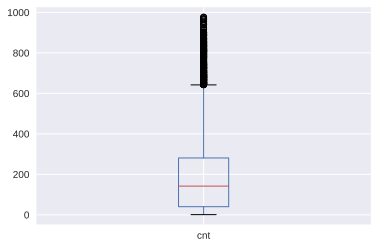

In [175]:
data.boxplot(column=[TARGET])
plt.show()

**Conclusion** 
* This feature has many outlaiers, near 650+.
* The median is around 190, and 5 after log transformation.

## **Numeric features**

In [176]:
NUMERICAL = ['temp', 'atemp', 'hum', 'windspeed', 'casual', 'registered', 'cnt']

**Distribution**

In [177]:
draw_histograms(data, NUMERICAL)

Output hidden; open in https://colab.research.google.com to view.

* Looking at distributions, I can say, that they are quite normal, exept target and casual and registered. So, these features can be log transformed.

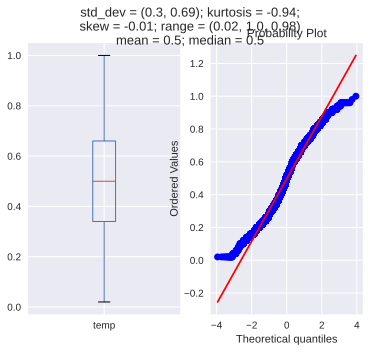

In [178]:
get_numeric_analysis(data,"temp")

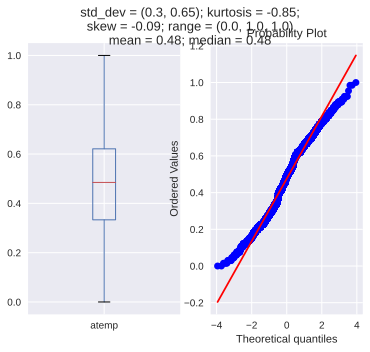

In [179]:
get_numeric_analysis(data,"atemp")

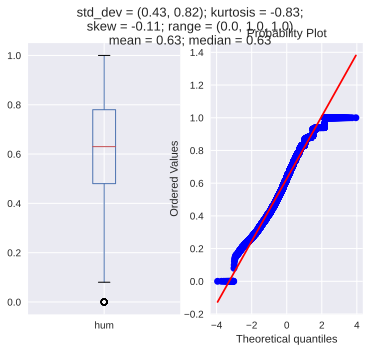

In [180]:
get_numeric_analysis(data,"hum")

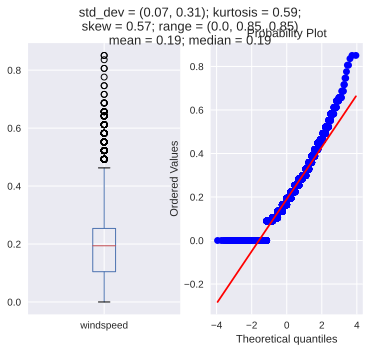

In [181]:
get_numeric_analysis(data,"windspeed")

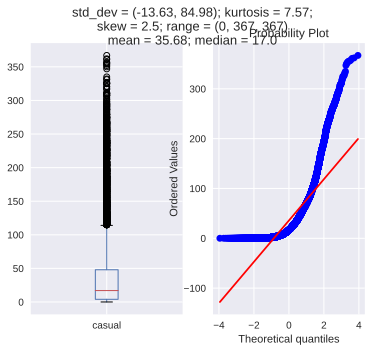

In [182]:
get_numeric_analysis(data,"casual")

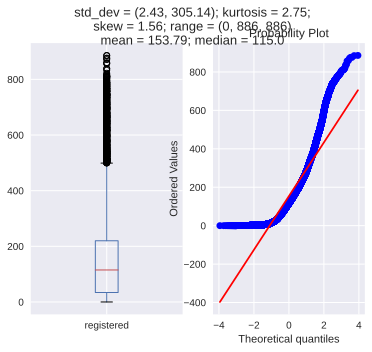

In [183]:
get_numeric_analysis(data,"registered")

* It's obvious that windspeed, casual and registered have a huge amount of outliers.

## **Time Series**

In [184]:
df_ts = data.copy(deep=True)

In [185]:
df_ts['dteday'] = pd.to_datetime(df_ts['dteday'], format='%Y-%m-%d')

In [186]:
monthly = df_ts.copy(deep=True)
monthly['dteday'] = monthly['dteday'].apply(lambda x: x.strftime('%Y-%m'))

In [187]:
df = df_ts.set_index('dteday')
df.head(1)

,instant,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16


**Resampling**
Down Sampling  
Converting the data to a less frequent interval (daily to monthly) by using the mean

In [188]:
df_monthly =  df.resample('MS')
df_mean = df_monthly.mean()
df_mean.head(3)

,instant,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,,,
2011-01-01,344.5,1.000000,0.0,1.0,11.872093,0.034884,2.933140,0.623547,1.473837,0.197413,0.203758,0.574055,0.197485,4.466570,51.040698,55.507267
2011-02-01,1013.0,1.000000,0.0,2.0,11.785824,0.036980,3.015408,0.671803,1.454545,0.283975,0.285730,0.559707,0.229451,9.617874,64.673344,74.291217
2011-03-01,1702.5,1.356164,0.0,3.0,11.652055,0.000000,3.016438,0.741096,1.554795,0.331233,0.324879,0.570055,0.232225,17.569863,70.163014,87.732877


The dates need to be consistent year over year (weekday only trading and holidays add variance to the specific trading dates).

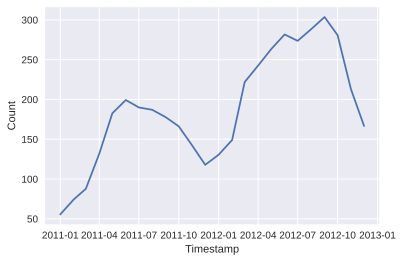

In [189]:
ax = sns.lineplot(x = df_mean.index, y = "cnt", data = df_mean);
ax.set(xlabel = 'Timestamp', ylabel = 'Count')
plt.show()

* We are already seeing obvious growth over time. Demand has been increasing, but seasonality is also present in the data. In the future, all this will be considered in more detail.

### **Plotting timestamp and numerical features**

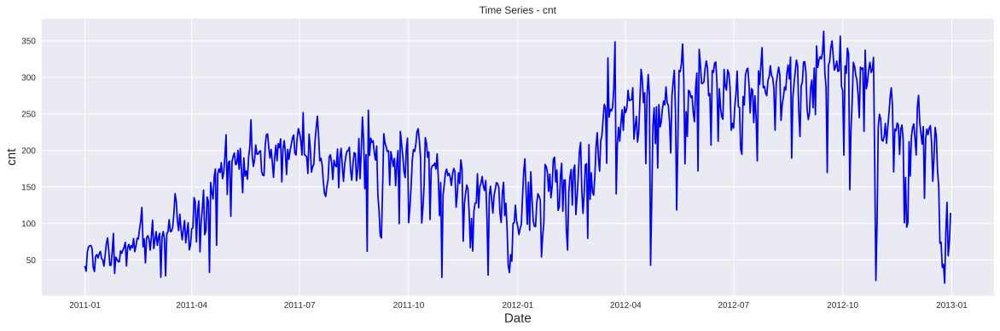

In [190]:
plot_data_feature(df_ts, TARGET, 'b')

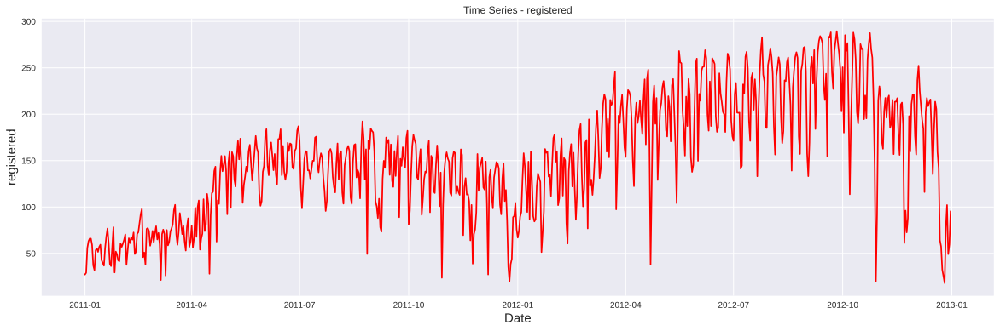

In [191]:
plot_data_feature(df_ts, 'registered', 'r')

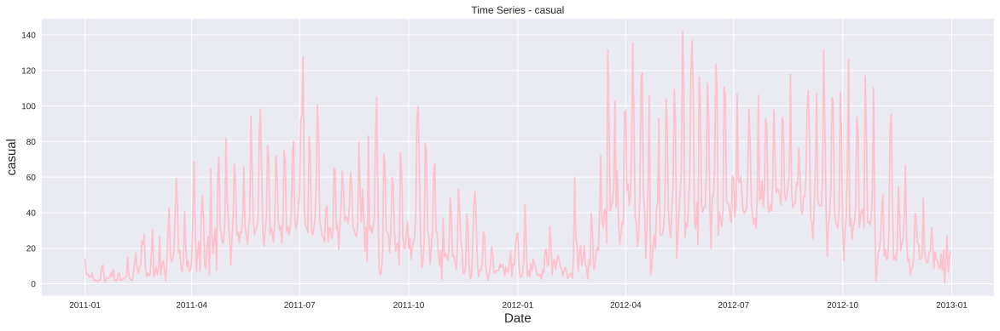

In [192]:
plot_data_feature(df_ts, 'casual', 'pink')

**Conclusion**

* The first thing to notice is seasonality: every July (ant all warm period) there is a big jump. In summer, the demand for bikes is higher, and in winter, the demand is lower for each year. Also, there seems to be a trend: it seems to go up a bit, then down, up again and then down again. In other words, it looks like there are trends and seasonal components in these time series.

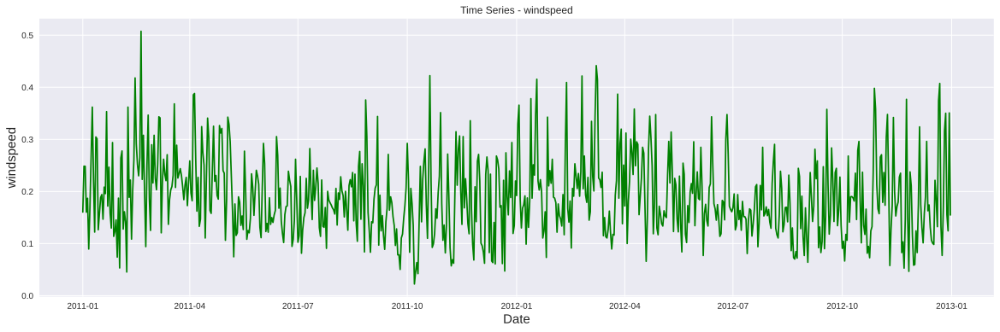

In [193]:
plot_data_feature(df_ts, 'windspeed', 'g')

**Conclusion**

* The first thing I would like to note is the absence of any trends in the wind.

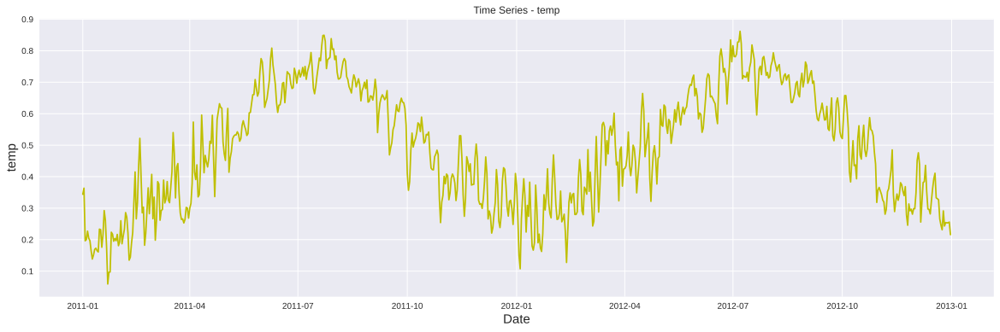

In [194]:
plot_data_feature(df_ts, 'temp', 'y')

**Conclusion**

* The first thing to pay attention to is seasonality: there is a big jump during the whole warm period. The temperature, as expected, is high.

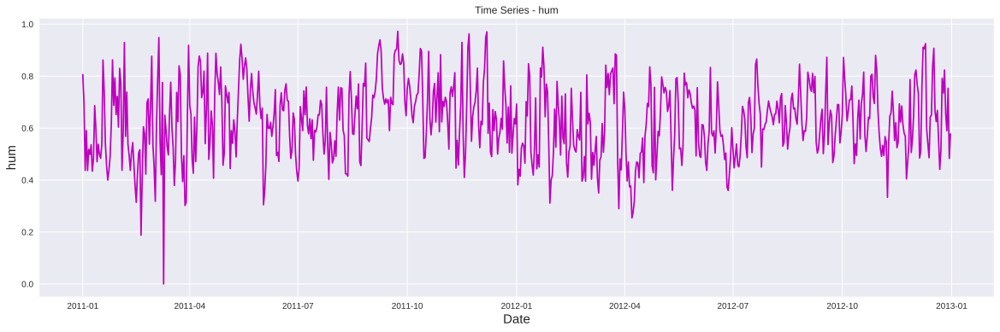

In [195]:
plot_data_feature(df_ts, 'hum', 'm')

**Conclusion**

* I guess, that there are no trand and seasonality. 

### **Decomposition**

In [196]:
df = data.copy(deep=True)
df['dteday'] = pd.to_datetime(df['dteday'], format='%Y-%m-%d')

In [197]:
monthly = df.copy(deep=True)
monthly['dteday'] = monthly['dteday'].apply(lambda x: x.strftime('%Y-%m'))

In [198]:
df1 = df[['dteday','cnt']].groupby(['dteday'])['cnt'].mean()

df1.head(3)

dteday
2011-01-01    41.041667
2011-01-02    34.826087
2011-01-03    61.318182
Name: cnt, dtype: float64

### **Multiplicative Model**

   A given time series is thought to consist of three systematic components including level, trend, seasonality, and one non-systematic component called noise. These components are defined as follows:

**Level**: The average value in the series.  

**Trend**: The increasing or decreasing value in the series.

**Seasonality**: The repeating short-term cycle in the series.

**Noise**: The random variation in the series.

**Combining Time Series Components  **
A series is thought to be an aggregate or combination of these four components. All series have a level and noise. The trend and seasonality components are optional. 

Multiplicative Model: *y(t) = Level x Trend x Seasonality x Noise*



* In *seasonal_decompose* we have to set the model. We can either set the model to be *Additive* or *Multiplicative*.

* A rule of thumb for selecting the right model is to see in our plot if the trend and seasonal variation are relatively constant over time, in other words, **linear**. If yes, then we will select the **Additive model**. Otherwise, if the trend and seasonal variation **increase or decrease** over time then we use the **Multiplicative model**.

* Thus, looking at our  target, I can cay that it is not linear and increase with time, so I choose the **Multiplicative model**.

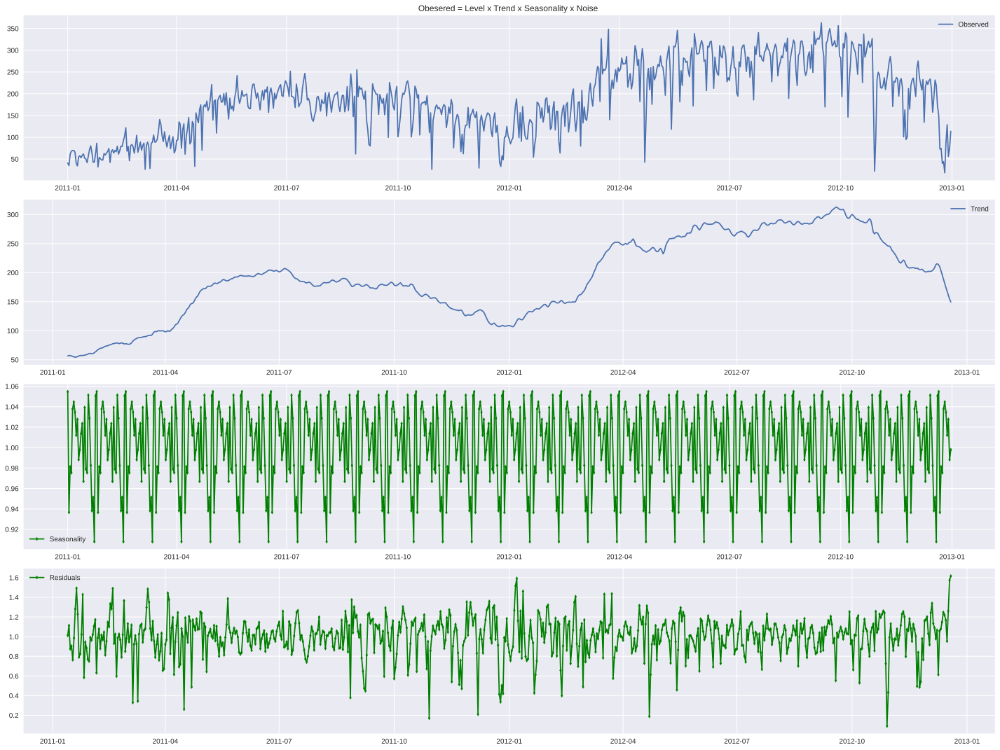

In [199]:
times_series_means =  pd.DataFrame(df1).reset_index(drop=False)
df_date_index = times_series_means[['dteday','cnt']].set_index('dteday')
decomposition = seasonal_decompose(df_date_index, model='multiplicative',period = 24)
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid
rcParams['figure.figsize'] = 20, 15

plt.subplot(411)
plt.title('Obesered = Level x Trend x Seasonality x Noise ')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')

plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')

plt.subplot(413)
plt.plot(seasonal, '-gd', label='Seasonality', markersize=4)
plt.legend(loc='best')

plt.subplot(414)
plt.plot(residual,  '-gd', label='Residuals',  markersize=4)
plt.legend(loc='best')
plt.tight_layout()
plt.show()

**Conclusion**


**Trend** : it is clear that a certain trend is present in the data, we see that first there is an increase, then a decline, and next year the situation will get worse.

**Seasonality** : probably also takes place. (More demand in summer, less in winter)

**Noise** : Describes what remains behind the separation of seasonality and trend from the time series.

* We can see that the trend and seasonality information extracted from the series does seem reasonable. The residuals are also interesting, showing periods of high variability in the early and later years of the series.



### **Analysis of decomposition residuals**

In [200]:
rcParams['figure.figsize'] = 6, 5

**Residual Histogram and Density Plots**


* I would expect the forecast errors to be normally distributed around a zero mean.  

* I can see that the distribution does have a Gaussian look, but is perhaps more pointy, showing an exponential distribution with some asymmetry.



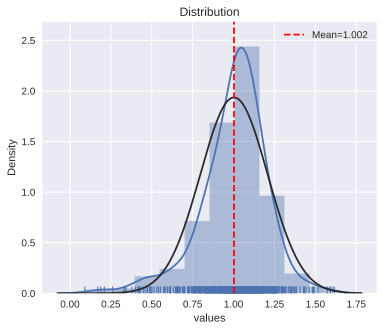

In [201]:
draw_histogram(residual)

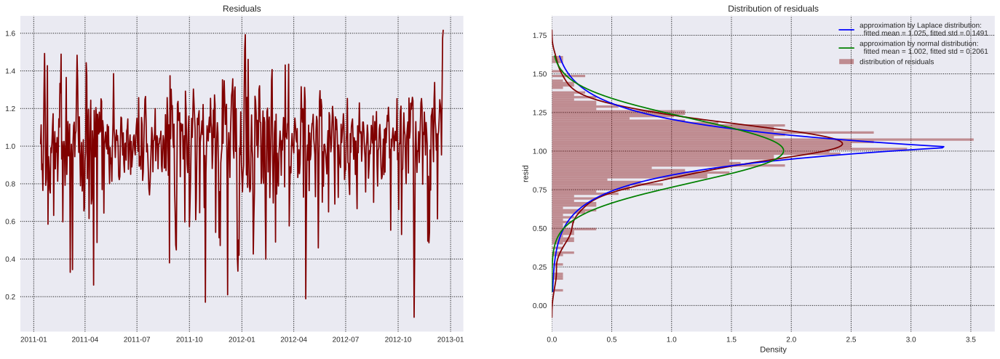

In [202]:
resid = decomposition.resid

draw_resid_decomposition(resid)

* It is worth noting that the Laplace distribution is more suitable for these residuals.

**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.

* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.  

* The plot is helpful to spot obvious departures from this expectation.  

* This plot shows that the distribution is seemingly normal with a few bumps and outliers.

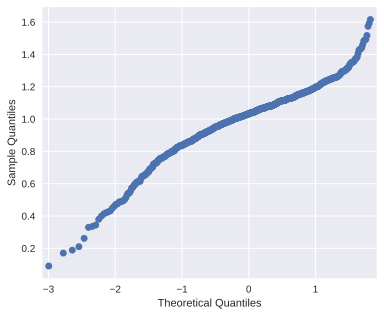

In [203]:
residual = decomposition.resid
residual = np.array(residual)
qqplot(residual)
plt.show()

Check weather the resid. disrtibution is Laplace or normal:

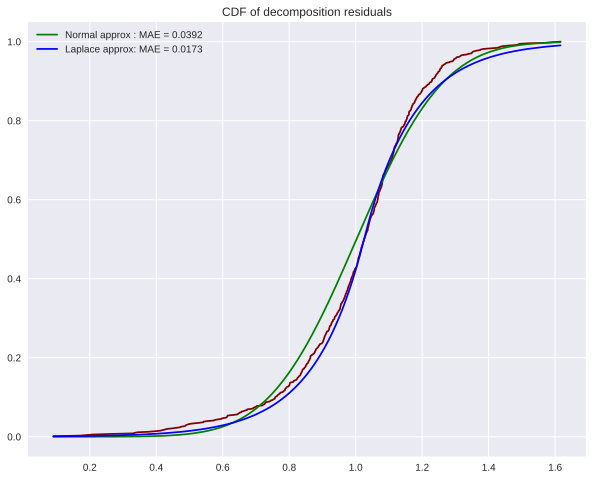

2.2621459712112912


In [204]:
resid = decomposition.resid

ecdf_resid_instance = ECDF(resid.dropna())
resid_arr = resid.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)
resid_arr

loc_laplace, scale_laplace = st.laplace.fit(resid.dropna())
loc_norm, scale_norm = st.norm.fit(resid.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)


mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)


plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()

print(mae_norm/mae_laplace)

* Errors have Laplace distribution.  MAE  metric proofs it.

### **Stationarity of a Time Series**
* There are three basic criterion for a time series to understand whether it is stationary series or not.
  + Statistical properties of time series such as mean, variance should remain constant over time to call time series is stationary
    - constant mean
    - constant variance
    - autocovariance that does not depend on time. 




* I can check stationarity using the following methods:
  - **Plotting Rolling Statistics:** We have a window lets say window size is 6 and then we find rolling mean and variance to check stationary.
  - **Dickey-Fuller Test:** The test results comprise of a Test Statistic and some Critical Values for difference confidence levels. If the test statistic is less than the critical value, we can say that time series is stationary
  - **KPSS Test:** (Null hypothesis - The process is stationary)

**ADF & KPSS** 

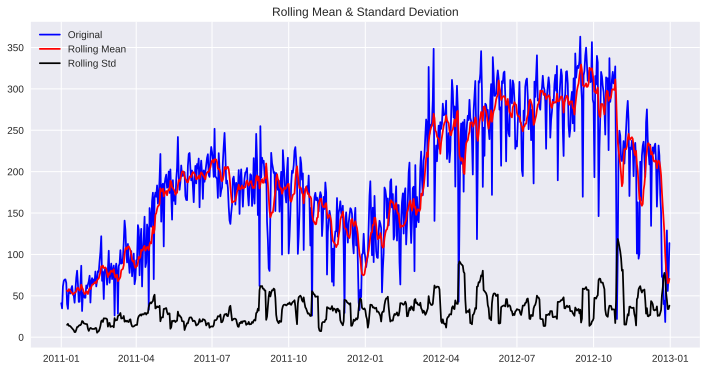

*** Results of Dickey-Fuller Test (Null hypothesis - The process is non-stationary) ***
Test Statistic                  -1.867746
p-value                          0.347383
#Lags Used                      13.000000
Number of Observations Used    717.000000
Critical Value (1%)             -3.439503
Critical Value (5%)             -2.865579
Critical Value (10%)            -2.568921
dtype: float64
The process is non-stationary.


*** Kwiatkowski–Phillips–Schmidt–Shin (KPSS) test (Null hypothesis - The process is stationary) ***
KPSS Statistic = 2.4262096776625546
p-value = 0.01
The process is non-stationary.



In [205]:
stationarity_check(df_date_index['cnt'])

* Our first criteria for stationary is constant mean. So we fail because mean is not constant as you can see from plot(black line) above . (no stationary)
* Second one is constant variance. It looks like constant. (yes stationary)
* Third one is  **test statistics**. Lets look:
    - Results of Dickey-Fuller Test 
        + The process is non-stationary.

    - KPSS test 
        + The process is non-stationary.

* As a result, we sure that our time series is **not stationary**.
* Lets make time series stationary at the next part.

### **Make a Time Series Stationary**  

* As it was mentioned before, there are 2 reasons behind non-stationarity of time series
  - **Trend**: varying mean over time. We need constant mean for stationary of time series.
  - **Seasonality**: variations at specific time. We need constant variations for stationary of time series.
* First solve trend(constant mean) problem
  - Most popular method is moving average.
      + Moving average: We have window that take the average over the past 'n' sample. 'n' is window size.

In [206]:
df['dteday'] = pd.to_datetime(df['dteday'], format='%Y-%m-%d')

df = df.set_index('dteday')
df.head(1)

,instant,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16


In [207]:
ts = df.loc[:, [TARGET]]
ts.head(1)

,cnt
dteday,
2011-01-01,16


### **Moving average method**

There are several ways to determine trends in time series, as well as to achieve stationarity. One popular way is to use a moving average, which means that for each time point you take the average of the points on either side of it.

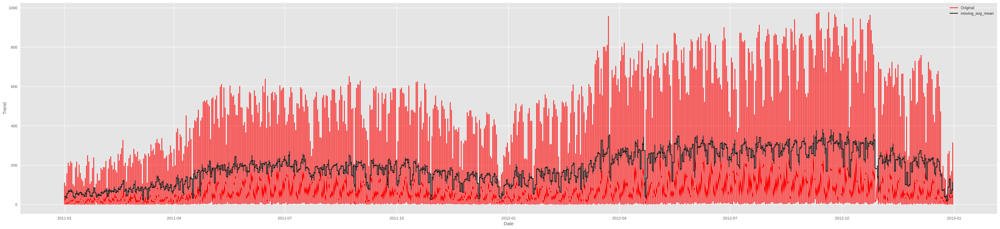

In [208]:
plt.style.use('ggplot')
window_size = 24
moving_avg = ts.rolling(window_size).mean()
plt.figure(figsize=(45,10))
plt.plot(ts, color = "red",label = "Original")
plt.plot(moving_avg, color='black', label = "moving_avg_mean")

plt.xlabel("Date")
plt.ylabel("Trend")
plt.legend()
plt.show()

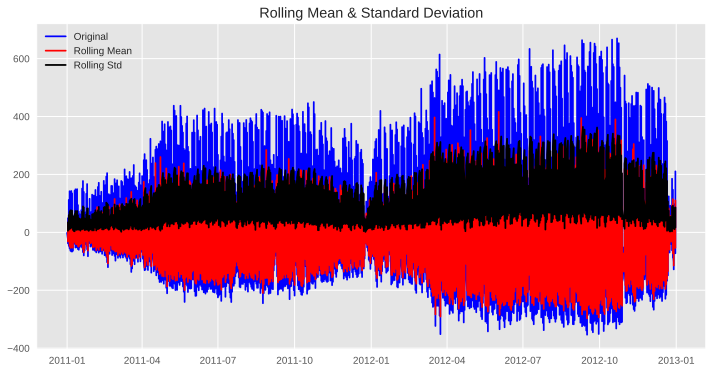

*** Results of Dickey-Fuller Test (Null hypothesis - The process is non-stationary) ***
Test Statistic                   -26.695084
p-value                            0.000000
#Lags Used                        42.000000
Number of Observations Used    17313.000000
Critical Value (1%)               -3.430728
Critical Value (5%)               -2.861707
Critical Value (10%)              -2.566859
dtype: float64
The process is stationary.


*** Kwiatkowski–Phillips–Schmidt–Shin (KPSS) test (Null hypothesis - The process is stationary) ***
KPSS Statistic = 0.007755975918890809
p-value = 0.1
The process is stationary.



In [209]:
ts_moving_avg_diff = ts - moving_avg
ts_moving_avg_diff.dropna(inplace=True) 

# check stationary
stationarity_check(ts_moving_avg_diff)

**Conclusion**  

* Constant mean criteria: mean looks like constant as you can see from plot(black line) above . (yes stationary)

* Second one is constant variance. It looks like constant. (yes stationary)

* The test statistics:
   + Dickey-Fuller Test 
       - The process is stationary.
   + KPSS test 
       - The process is stationary.

* I achieve stationary time series. 


### **Differencing method**

* It is also one of the most common method. Idea is that take difference between time series and shifted time series.

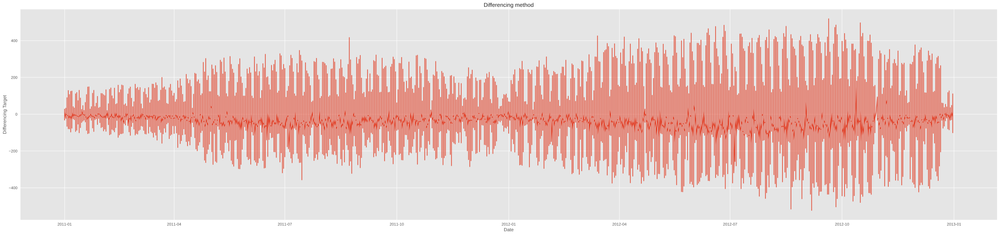

In [210]:
ts_diff = ts - ts.shift()
plt.figure(figsize=(45,10))
plt.plot(ts_diff)
plt.title("Differencing method") 
plt.xlabel("Date")
plt.ylabel("Differencing Target")
plt.show()

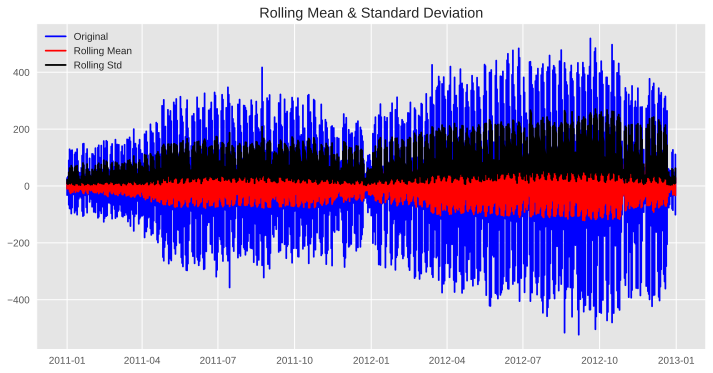

*** Results of Dickey-Fuller Test (Null hypothesis - The process is non-stationary) ***
Test Statistic                   -30.091582
p-value                            0.000000
#Lags Used                        44.000000
Number of Observations Used    17333.000000
Critical Value (1%)               -3.430727
Critical Value (5%)               -2.861707
Critical Value (10%)              -2.566859
dtype: float64
The process is stationary.


*** Kwiatkowski–Phillips–Schmidt–Shin (KPSS) test (Null hypothesis - The process is stationary) ***
KPSS Statistic = 0.01139749947345419
p-value = 0.1
The process is stationary.



In [211]:
ts_diff.dropna(inplace=True) # due to shifting there is nan values
# check stationary: mean, variance(std)and adfuller test
stationarity_check(ts_diff)

**Conclusion**  

* Constant mean criteria: mean looks like constant as you can see from plot(black line) above . (yes stationary)

* Second one is constant variance. It looks like constant. (yes stationary)

* The test statistics:
   + Dickey-Fuller Test 
       - The process is stationary.
   + KPSS test 
       - The process is stationary.

* I achieve stationary time series. 


### **Correlation Analysis**

A way to check the seasonality of a time series is to plot the autocorrelation function (FSA). In the presence of a strong seasonal pattern, the ACF graph usually reveals certain recurring spikes that are multiples of the seasonal window. Autocorrelation is a technique for analyzing seasonality. It plots the correlation of the time series with itself at a different time lag.

Lag – the number of previous observations measured during autocorrelation.  

Positive Correlation – A relationship where one value’s increase predicts an increase in another.

Negative Correlation – A relationship where one value’s increase predicts a decrease in another.

Confidence Interval – A calculated range of values in which would likely contain an unknown value for sampled data.

Confidence Level – Probability a confidence interval will contain an observed value.

In [212]:
N = len(ts_moving_avg_diff)
k = np.arange(0, N)
plot_acf(ts_moving_avg_diff, 
         lags=N-1, 
         vlines_kwargs={'color' : 'b'},
         markerfacecolor='b', markeredgecolor='b', 
         title='Autocorrelation of target');
plt.plot(k, 1-k/N, ':r')
plt.plot(k, -1+k/N, ':r')


N = len(trend.dropna())
k = np.arange(0, N)
plot_acf(trend.dropna(), 
         lags=N-1, 
         vlines_kwargs={'color' : 'navy'}, 
         markerfacecolor='navy', markeredgecolor='navy', 
         title='Autocorrelation of trend');
plt.plot(k, 1-k/N, ':r')
plt.plot(k, -1+k/N, ':r')


seasonal = decomposition.seasonal
N = len(seasonal)
k = np.arange(0, N)
plot_acf(seasonal, 
         lags=N-1, 
         vlines_kwargs={'color' : 'g'}, 
         markerfacecolor='g', markeredgecolor='g', 
         title='Autocorrelation of seasonal');
plt.plot(k, 1-k/N, ':r')
plt.plot(k, -1+k/N, ':r')


N = len(resid.dropna())
k = np.arange(0, N)
plot_acf(resid.dropna(), 
         lags=N-1,   
         vlines_kwargs={'color' : 'maroon'}, 
         markerfacecolor='maroon', markeredgecolor='maroon', 
         title='Autocorrelation of residuals');
plt.plot(k, 1-k/N, ':r')
plt.plot(k, -1+k/N, ':r')


plt.show()

Output hidden; open in https://colab.research.google.com to view.

* The red shaded region is the confidence interval with a default value of α = 0.05. Anything within this range represents a value that has no significant correlation with the most recent value for the price.

* The vertical lines with markers at their tops are the “lags” that represent a specific number of previous values. These represent the correlation value (shown on the y-axis) and diminish at a steady rate as their proximity from the current price increases. That’s not the case with all data but certainly so with ours.

* This lets us know that previous demand on bikes influences the current demand but the significance of that influence decreases steadily with time. 

* The strength of this relationship is measured on a scale of -1 to 1 when -1 being a 100% negative correlation and with a value of 1 being a 100% positive correlation. This measure is shown on the y-axis. 

* Here we see a small trend of positive and negative correlation emerge. 

* These data often reflect seasonal patterns with less data to predict frequency or strength of correlation. 

* Looking at the autocorrelation of the residues, we can say that they almost look like white noise. There is a certain seasonality in the data, the trend is expressed implicitly.

## **Multivariate analysis**

Analysis of variables I thought which are important.

**Seasons**

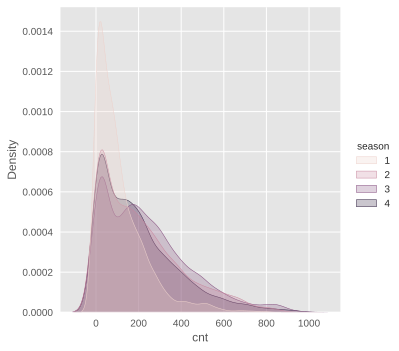

In [213]:
sns.displot(data, x=TARGET,hue ='season', kind ='kde', fill="True")
plt.show()

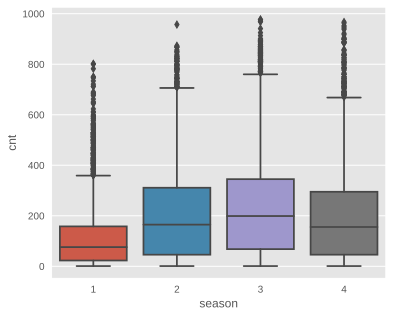

In [214]:
sns.boxplot(x='season', y=TARGET, data=data)
plt.show()

    1 = spring, 2 = summer, 3 = fall, 4 = winter
* The demand on bikes doesn't remain same for all the fours seasons, it is higher in fall and summer. 
* Spring has got the lowest count.

**Weather**

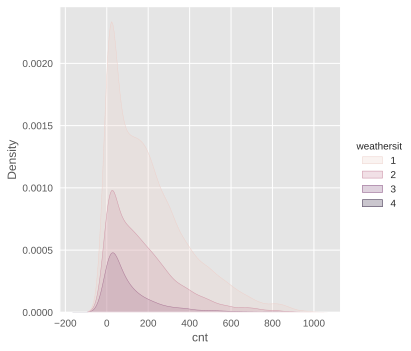

In [215]:
sns.displot(data, x=TARGET,hue ='weathersit',kind ='kde', fill="True")
plt.show()

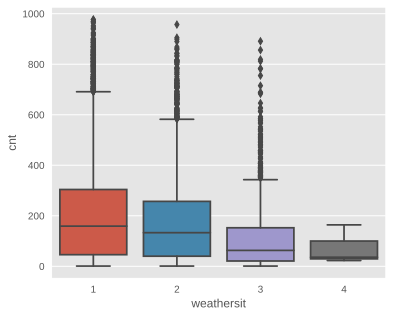

In [216]:
sns.boxplot(x="weathersit", y=TARGET, data=data)
plt.show()

         1: Clear, Few clouds, Partly cloudy, Partlycloudy 
         2: Mist + Cloudy, Mist + Broken clouds,   Mist + Few clouds, Mist 
         3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds 
         4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog

* The demand  on bikes doesn't remain same for all weather conditions.
* It's extremally high, when the weather is great(1).
* The lowest count when it is a terrible weather(4).

**Holiday**

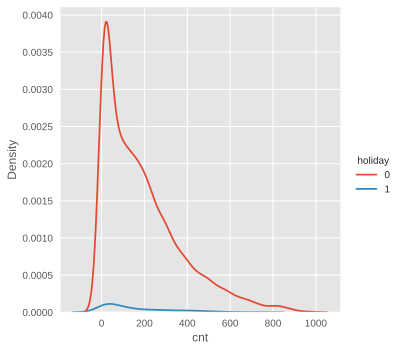

In [217]:
sns.displot(data, x=TARGET,hue ='holiday',kind ='kde')
plt.show()

* The majority of data is for non holiday days.

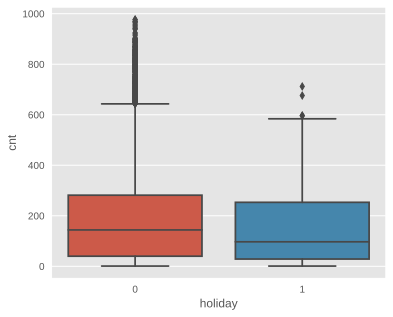

In [218]:
sns.boxplot(data=data,x="holiday", y=TARGET,orient="v")
plt.show()

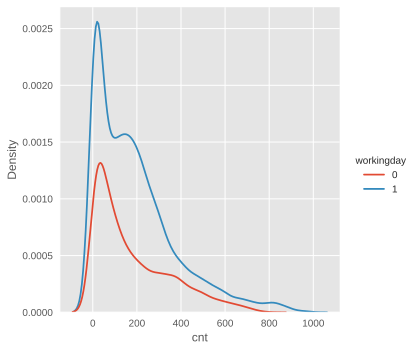

In [219]:
sns.displot(data, x=TARGET,hue ='workingday', kind ='kde')
plt.show()

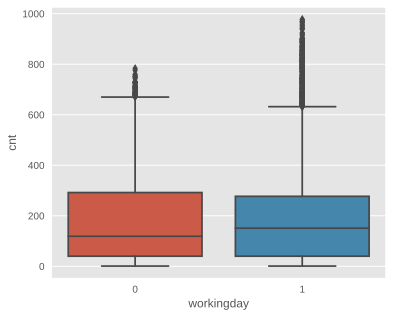

In [220]:
sns.boxplot(data=data,x="workingday", y=TARGET,orient="v")
plt.show()

    holiday - whether the day is considered a holiday
    workingday - whether the day is neither a weekend nor holiday

* The demand  on bikes is a little bit higher when it is a working day and not a holiday, median proves it.

* Temperature and windspeed have an great impact on bike demand.

* Temp and atemp plots are almost similar.This indicated high colinearity between the two feature.One of them has to be dropped to avoid the colinearity.

**Numeric features & Demand (cnt)**

In [221]:
draw_num_scatter(data, ['temp', 'atemp', 'hum', 'windspeed'])

Output hidden; open in https://colab.research.google.com to view.

**Categorical features**

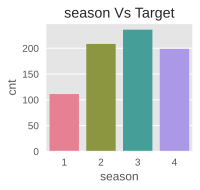

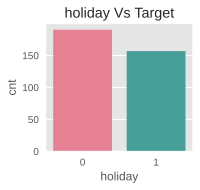

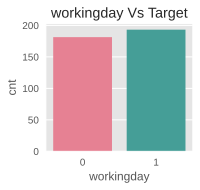

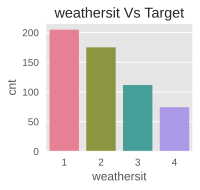

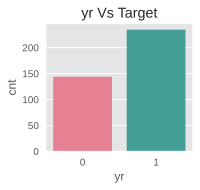

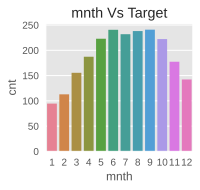

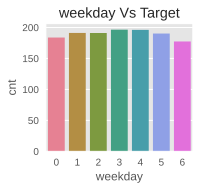

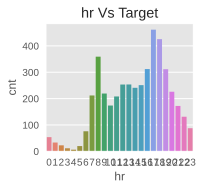

In [222]:
get_cat_analysis(data, ['season', 'holiday', 'workingday', 'weathersit', 'yr', 'mnth', 'weekday','hr' ])

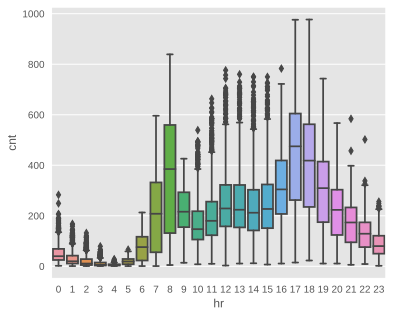

In [223]:
sns.boxplot(data=data,x="hr", y=TARGET,orient="v")
plt.show()

* (season) The demand for bikes is highest in the 3 season. And the lowest in the 1 season.

* This dataset has data for only two years .So the column of year can probably be dropped from the dataset.

* As for hours, it can be clearly made out that the demand for bikes is highest at 8 am and 5 pm. The boxplot of "Hour" is quiet interesting.The median value are relatively higher at 7AM - 8AM and 5PM - 6PM. It can be attributed to regular school and office users at that time.


* (months) It is quiet obvious that people tend to rent bike during summer season since it is really conducive to ride bike at that season. Therefore June, July and August has got relatively higher demand for bicycle.


## **Correlation**

* Evaluation of the pairwise dependencies of numerical features.
* Calculation and visualization of the correlation matrix.

In [224]:
NUMERICAL = ['temp', 'atemp', 'hum', 'windspeed', 'casual', 'registered', 'cnt']

In [225]:
num_data = data.loc[:,NUMERICAL]
corr_matrix = num_data.corr(method='pearson').round(4)
corr_matrix

,temp,atemp,hum,windspeed,casual,registered,cnt
temp,1.0000,0.9877,-0.0699,-0.0231,0.4596,0.3354,0.4048
atemp,0.9877,1.0000,-0.0519,-0.0623,0.4541,0.3326,0.4009
hum,-0.0699,-0.0519,1.0000,-0.2901,-0.3470,-0.2739,-0.3229
windspeed,-0.0231,-0.0623,-0.2901,1.0000,0.0903,0.0823,0.0932
casual,0.4596,0.4541,-0.3470,0.0903,1.0000,0.5066,0.6946
registered,0.3354,0.3326,-0.2739,0.0823,0.5066,1.0000,0.9722
cnt,0.4048,0.4009,-0.3229,0.0932,0.6946,0.9722,1.0000


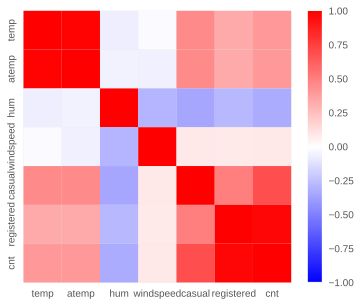

In [226]:
sns.heatmap(corr_matrix, vmin=-1, vmax=1, cmap='bwr')
plt.show()

**Conclusion**  
* It is important to understand that if the variables are strongly related to each other, then this can affect the training of the model in a bad way. The model will not adequately, in particular the linear model, calculate the weights and parameters of the model.
* At first glance, it is possible to distinguish a pair of red squares, the greatest dependence is observed between these features:  
 **'temp', 'atemp';**  
 **'casual', 'registered', 'cnt'**
 
* **temp** and **humidity** feature has got positive and negative correlation with **TARGET**.
* **atemp** is variable is not taken into account since "atemp" and "temp" has got very strong correlation with each other. During model building any one of the variable has to be dropped since they will exhibit multicollinearity in the data.
* **windspeed** is not gonna be really useful numerical feature and it is visible from it correlation value with **TARGET**.
* **hum** is inversely related to count as expected as the weather is humid, people will not like to travel on a bike.
* **registered/casual** and count are highly correlated which indicates that most of the bikes that are rented are registered.
* **casual** and **registered** are also not taken into account since they are leakage variables in nature and need to dropped during model building.

## **Correlation coefficients**

See multicollinearity between some features:

**'temp', 'atemp'**

In [227]:
np.corrcoef(data['temp'], data['atemp'])

array([[1.        , 0.98767214],
       [0.98767214, 1.        ]])

* This correlation is 0.99, a strong positive correlation, let’s take a look at a scatter chart.

In [228]:
sns.pairplot(data.loc[:, ['temp', 'atemp']])
plt.show()

Output hidden; open in https://colab.research.google.com to view.

**'casual', target**

In [229]:
np.corrcoef(data['casual'], data['cnt'])

array([[1.        , 0.69456408],
       [0.69456408, 1.        ]])

* This correlation is 0.79, a  positive correlation, let’s take a look at a scatter chart.

In [230]:
sns.pairplot(data.loc[:, ['casual', 'cnt']])
plt.show()

Output hidden; open in https://colab.research.google.com to view.

**'registered', target**

In [231]:
np.corrcoef(data['registered'], data['cnt'])

array([[1.        , 0.97215073],
       [0.97215073, 1.        ]])

* This correlation is 0.97, a strong positive correlation, let’s take a look at a scatter chart.

In [232]:
sns.pairplot(data.loc[:, ['registered', 'cnt']])
plt.show()

Output hidden; open in https://colab.research.google.com to view.

**Conclusion**  

* There are srting correlations between features, hence conclude the presence of multicollinearity in the data.
* The highest correlation with target have *'temp', 'atemp'* and *TARGET*, *'registered'* features.


# **Preprocessing/Feature Engineering**

In [233]:
endogenous_vars = ['season',  'mnth', 'hr', 'holiday', 'weekday',
       'workingday' , 'cnt'] # 'casual', 'registered' --> delete due to multicollinearity

exogenous_vars = ['weathersit', 'temp',  'hum', 'windspeed', 'cnt'] # atemp --> delete due to multicollinearity

**Endogenous data**

In [234]:
endog_data = df[endogenous_vars]
endog_data.head()

,season,mnth,hr,holiday,weekday,workingday,cnt
dteday,,,,,,,
2011-01-01,1,1,0,0,6,0,16
2011-01-01,1,1,1,0,6,0,40
2011-01-01,1,1,2,0,6,0,32
2011-01-01,1,1,3,0,6,0,13
2011-01-01,1,1,4,0,6,0,1


**exogenous data and decomposed target**

In [235]:
targ_ex_data = df[exogenous_vars]
targ_ex_data.head()

,weathersit,temp,hum,windspeed,cnt
dteday,,,,,
2011-01-01,1,0.24,0.81,0.0,16
2011-01-01,1,0.22,0.80,0.0,40
2011-01-01,1,0.22,0.80,0.0,32
2011-01-01,1,0.24,0.75,0.0,13
2011-01-01,1,0.24,0.75,0.0,1


**Decomposition of target**

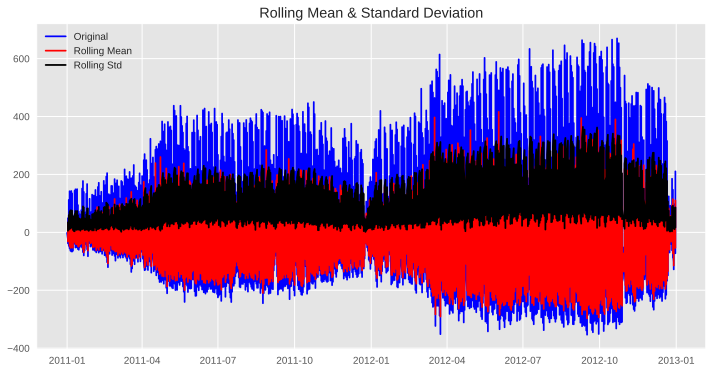

*** Results of Dickey-Fuller Test (Null hypothesis - The process is non-stationary) ***
Test Statistic                   -26.695084
p-value                            0.000000
#Lags Used                        42.000000
Number of Observations Used    17313.000000
Critical Value (1%)               -3.430728
Critical Value (5%)               -2.861707
Critical Value (10%)              -2.566859
dtype: float64
The process is stationary.


*** Kwiatkowski–Phillips–Schmidt–Shin (KPSS) test (Null hypothesis - The process is stationary) ***
KPSS Statistic = 0.007755975918890809
p-value = 0.1
The process is stationary.



In [236]:
window_size = 24
moving_avg = targ_ex_data['cnt'].rolling(window_size).mean()

ts_moving_avg_diff = targ_ex_data['cnt'] - moving_avg
ts_moving_avg_diff1 = targ_ex_data['cnt'] - moving_avg

ts_moving_avg_diff1.dropna(inplace=True)

# check stationary
stationarity_check(ts_moving_avg_diff1)

* Target is stationary.

In [237]:
targ_ex_data['dec_cnt'] = ts_moving_avg_diff
targ_ex_data.shape

(17379, 6)

In [238]:
targ_ex_data.dropna(inplace=True)

In [239]:
targ_ex_data.shape

(17356, 6)

In [240]:
targ_ex_data.head(5)

,weathersit,temp,hum,windspeed,cnt,dec_cnt
dteday,,,,,,
2011-01-01,2,0.46,0.88,0.2985,39,-2.041667
2011-01-02,2,0.46,0.88,0.2985,17,-24.083333
2011-01-02,2,0.44,0.94,0.2537,17,-23.125000
2011-01-02,2,0.42,1.00,0.2836,9,-30.166667
2011-01-02,2,0.46,0.94,0.1940,6,-32.875000


In [241]:
endog_data.shape

(17379, 7)

In [242]:
endog_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17379 entries, 2011-01-01 to 2012-12-31
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   season      17379 non-null  int64
 1   mnth        17379 non-null  int64
 2   hr          17379 non-null  int64
 3   holiday     17379 non-null  int64
 4   weekday     17379 non-null  int64
 5   workingday  17379 non-null  int64
 6   cnt         17379 non-null  int64
dtypes: int64(7)
memory usage: 1.1 MB


## **Outliers**

**IQR method**

**Endogenous**

In [243]:
count_iqr(endog_data.loc[:,[TARGET]])

cnt -> outliers: -> 158


Delete outliers to improve the model stability

In [244]:
Q1 = endog_data.quantile(0.25)
Q3 = endog_data.quantile(0.75)
IQR = Q3 - Q1
endog_data = endog_data[~((endog_data < (Q1 - 1.5 * IQR)) |(endog_data > (Q3 + 1.5 * IQR))).any(axis=1)]
endog_data.shape

(16376, 7)

**Exogenous**

In [245]:
count_iqr(targ_ex_data.loc[:,[TARGET]])

cnt -> outliers: -> 156


Delete outliers to improve the model stability

In [246]:
Q1 = targ_ex_data.quantile(0.25)
Q3 = targ_ex_data.quantile(0.75)
IQR = Q3 - Q1
print(IQR)


weathersit      1.000000
temp            0.320000
hum             0.300000
windspeed       0.149200
cnt           241.000000
dec_cnt       192.979167
dtype: float64


In [247]:
targ_ex_data = targ_ex_data[~((targ_ex_data < (Q1 - 1.5 * IQR)) |(targ_ex_data > (Q3 + 1.5 * IQR))).any(axis=1)]
targ_ex_data.shape

(16366, 6)

**Z-SCORE method**

In [248]:
for col in [TARGET]:
    Zscore_outlier(endog_data[col], col)

cnt:
Outliers amount: 16



In [249]:
Zscore_outlier(targ_ex_data[TARGET], TARGET)

cnt:
Outliers amount: 43



**Conclusion**
* Analyzing the emissions, in general, there are not very many of them.
* I can delete outlier values if it is due to data entry error, data processing error or outlier observations are very small in numbers. I can also use trimming at both ends to remove outliers. 
* But deleting the observation is not a good idea when we have small dataset.

* Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.

So, later I'll use some **transformation methods.**

## **Missing values**

In [250]:
endog_data.isnull().sum()

season        0
mnth          0
hr            0
holiday       0
weekday       0
workingday    0
cnt           0
dtype: int64

In [251]:
targ_ex_data.isnull().sum()

weathersit    0
temp          0
hum           0
windspeed     0
cnt           0
dec_cnt       0
dtype: int64

* As it can be seen, there are no missing values in data.

## **Dropping duplicates**



Then I **drop duplicates** in Dataset.

In [252]:
endog_data.shape

(16376, 7)

In [253]:
endog_data.drop_duplicates(inplace=True)
endog_data.shape

(15537, 7)

* 541 duplicates were found & deleted in dataset

In [254]:
targ_ex_data.shape

(16366, 6)

In [255]:
targ_ex_data.drop_duplicates(inplace=True)
targ_ex_data.shape

(16364, 6)

* no duplicates were found & deleted in dataset

## **Encoding**

In [256]:
endog_data = pd.get_dummies(endog_data, columns = [ 'season',  'mnth', 'hr', 'holiday', 'weekday',
       'workingday'])
endog_data.head()

,cnt,season_1,season_2,season_3,season_4,mnth_1,mnth_2,mnth_3,mnth_4,mnth_5,mnth_6,mnth_7,mnth_8,mnth_9,mnth_10,mnth_11,mnth_12,hr_0,hr_1,hr_2,hr_3,hr_4,hr_5,hr_6,hr_7,hr_8,hr_9,hr_10,hr_11,hr_12,hr_13,hr_14,hr_15,hr_16,hr_17,hr_18,hr_19,hr_20,hr_21,hr_22,hr_23,holiday_0,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,workingday_0,workingday_1
dteday,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,16,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,40,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,32,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,13,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0


In [257]:
targ_ex_data =  pd.get_dummies(targ_ex_data, columns = ['weathersit'])
targ_ex_data.head()

,temp,hum,windspeed,cnt,dec_cnt,weathersit_1,weathersit_2,weathersit_3
dteday,,,,,,,,
2011-01-01,0.46,0.88,0.2985,39,-2.041667,0,1,0
2011-01-02,0.46,0.88,0.2985,17,-24.083333,0,1,0
2011-01-02,0.44,0.94,0.2537,17,-23.125000,0,1,0
2011-01-02,0.42,1.00,0.2836,9,-30.166667,0,1,0
2011-01-02,0.46,0.94,0.1940,6,-32.875000,0,1,0


# **Split**

Test sample: get last month of data

**Endogenous train split**

In [258]:
trainData = endog_data['2011-01':'2012-11']
trainData.head()

,cnt,season_1,season_2,season_3,season_4,mnth_1,mnth_2,mnth_3,mnth_4,mnth_5,mnth_6,mnth_7,mnth_8,mnth_9,mnth_10,mnth_11,mnth_12,hr_0,hr_1,hr_2,hr_3,hr_4,hr_5,hr_6,hr_7,hr_8,hr_9,hr_10,hr_11,hr_12,hr_13,hr_14,hr_15,hr_16,hr_17,hr_18,hr_19,hr_20,hr_21,hr_22,hr_23,holiday_0,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,workingday_0,workingday_1
dteday,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,16,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,40,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,32,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,13,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0


In [259]:
train_label = trainData['cnt']
train_label.head()

dteday
2011-01-01    16
2011-01-01    40
2011-01-01    32
2011-01-01    13
2011-01-01     1
Name: cnt, dtype: int64

In [260]:
trainData.drop(TARGET, axis=1, inplace=True)
trainData.head()

,season_1,season_2,season_3,season_4,mnth_1,mnth_2,mnth_3,mnth_4,mnth_5,mnth_6,mnth_7,mnth_8,mnth_9,mnth_10,mnth_11,mnth_12,hr_0,hr_1,hr_2,hr_3,hr_4,hr_5,hr_6,hr_7,hr_8,hr_9,hr_10,hr_11,hr_12,hr_13,hr_14,hr_15,hr_16,hr_17,hr_18,hr_19,hr_20,hr_21,hr_22,hr_23,holiday_0,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,workingday_0,workingday_1
dteday,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2011-01-01,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0


**Exogenous and decomposed target train split**


In [261]:
trainDataExog =  targ_ex_data['2011-01':'2012-11']
trainDataExog.head(2)

,temp,hum,windspeed,cnt,dec_cnt,weathersit_1,weathersit_2,weathersit_3
dteday,,,,,,,,
2011-01-01,0.46,0.88,0.2985,39,-2.041667,0,1,0
2011-01-02,0.46,0.88,0.2985,17,-24.083333,0,1,0


In [262]:
train_label_exog = trainDataExog['dec_cnt']
train_label_exog.head()

dteday
2011-01-01    -2.041667
2011-01-02   -24.083333
2011-01-02   -23.125000
2011-01-02   -30.166667
2011-01-02   -32.875000
Name: dec_cnt, dtype: float64

In [263]:
trainDataExog.drop([TARGET, 'dec_cnt'], axis=1, inplace=True)
trainDataExog.head()

,temp,hum,windspeed,weathersit_1,weathersit_2,weathersit_3
dteday,,,,,,
2011-01-01,0.46,0.88,0.2985,0,1,0
2011-01-02,0.46,0.88,0.2985,0,1,0
2011-01-02,0.44,0.94,0.2537,0,1,0
2011-01-02,0.42,1.00,0.2836,0,1,0
2011-01-02,0.46,0.94,0.1940,0,1,0


**Endogenous test split**

In [264]:
testData = endog_data['2012-12']
testData.head()

,cnt,season_1,season_2,season_3,season_4,mnth_1,mnth_2,mnth_3,mnth_4,mnth_5,mnth_6,mnth_7,mnth_8,mnth_9,mnth_10,mnth_11,mnth_12,hr_0,hr_1,hr_2,hr_3,hr_4,hr_5,hr_6,hr_7,hr_8,hr_9,hr_10,hr_11,hr_12,hr_13,hr_14,hr_15,hr_16,hr_17,hr_18,hr_19,hr_20,hr_21,hr_22,hr_23,holiday_0,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,workingday_0,workingday_1
dteday,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2012-12-01,108,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,69,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,15,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,5,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,13,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0


In [265]:
test_label = testData['cnt']
test_label.head()

dteday
2012-12-01    108
2012-12-01     69
2012-12-01     15
2012-12-01      5
2012-12-01     13
Name: cnt, dtype: int64

In [266]:
testData.drop(TARGET, axis=1, inplace=True)
testData.head()

,season_1,season_2,season_3,season_4,mnth_1,mnth_2,mnth_3,mnth_4,mnth_5,mnth_6,mnth_7,mnth_8,mnth_9,mnth_10,mnth_11,mnth_12,hr_0,hr_1,hr_2,hr_3,hr_4,hr_5,hr_6,hr_7,hr_8,hr_9,hr_10,hr_11,hr_12,hr_13,hr_14,hr_15,hr_16,hr_17,hr_18,hr_19,hr_20,hr_21,hr_22,hr_23,holiday_0,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,workingday_0,workingday_1
dteday,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2012-12-01,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0
2012-12-01,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0


**Exogenous test split**



In [267]:
testDataExog = targ_ex_data['2012-12']
testDataExog.head()

,temp,hum,windspeed,cnt,dec_cnt,weathersit_1,weathersit_2,weathersit_3
dteday,,,,,,,,
2012-12-01,0.26,0.81,0.0000,108,-130.500000,1,0,0
2012-12-01,0.26,0.81,0.0000,69,-171.583333,1,0,0
2012-12-01,0.26,0.81,0.0000,50,-192.166667,0,1,0
2012-12-01,0.26,0.81,0.1343,15,-227.625000,0,1,0
2012-12-01,0.26,0.81,0.0896,5,-237.708333,1,0,0


In [268]:
test_label_exog = testDataExog['dec_cnt']
test_label_exog.head()

dteday
2012-12-01   -130.500000
2012-12-01   -171.583333
2012-12-01   -192.166667
2012-12-01   -227.625000
2012-12-01   -237.708333
Name: dec_cnt, dtype: float64

In [269]:
testDataExog.drop(['dec_cnt', TARGET], axis=1, inplace=True)
testDataExog.head()

,temp,hum,windspeed,weathersit_1,weathersit_2,weathersit_3
dteday,,,,,,
2012-12-01,0.26,0.81,0.0000,1,0,0
2012-12-01,0.26,0.81,0.0000,1,0,0
2012-12-01,0.26,0.81,0.0000,0,1,0
2012-12-01,0.26,0.81,0.1343,0,1,0
2012-12-01,0.26,0.81,0.0896,1,0,0


# **Standartisation**

* Since we are working with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. So, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

* To solve this problem, I later perform *STANDARDIZATION* of the data.


In [270]:
numerical = ['temp', 'hum', 'windspeed']
numeric_transformer = StandardScaler()
trainDataExog[numerical] = numeric_transformer.fit_transform(trainDataExog[numerical])
testDataExog[numerical] = numeric_transformer.transform(testDataExog[numerical])

# **Linear Regression**

Construct the baseline model using Linear Regression keeping in data only endogenous features.

## **Simple model**

In [ ]:
lr_model = LinearRegression()
lr_model.fit(trainData, train_label)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
pred = lr_model.predict(testData)

### **Look at feature importance**

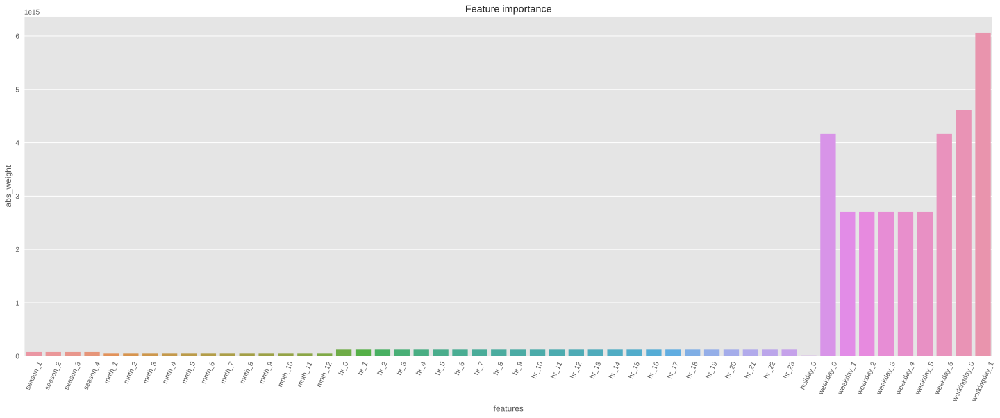

In [ ]:
get_feat_imp_coef(lr_model, trainData)

* Looking at the features and their importance for the model, it is quite logical to see among the important features: the days of the week and whether it is a working day or not, since in EDA it was revealed that from the day of the week and from whether it is a working day or not, the demand for bicycles also grows.


### **Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


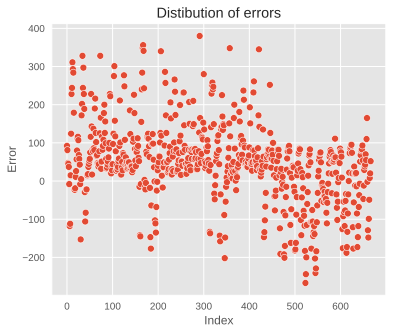

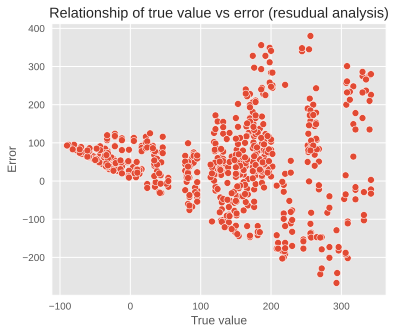

In [ ]:
errors = test_label - pred
draw_res_analys(errors, pred)

**Conclusion**
* The trend in the second figure is visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.


**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.7549384580168603), ('p-value', 0.9926702441762262)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

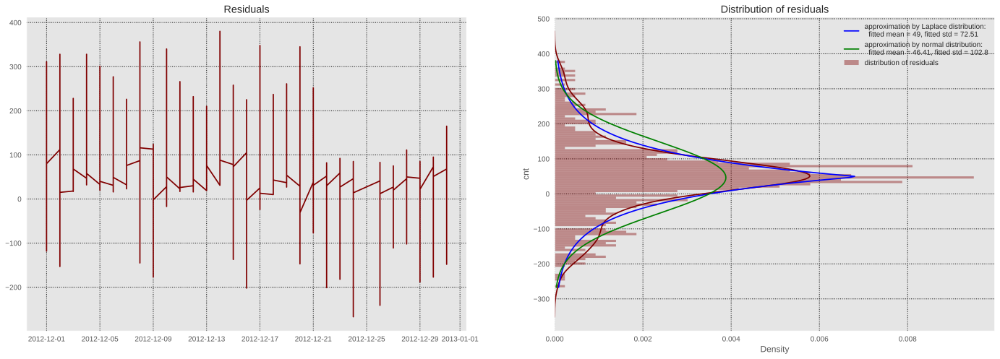

In [ ]:
draw_resid_decomposition(errors)

It is worth noting that the Laplace distribution is more suitable for these residuals.

**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.
* This plot shows that the distribution is seemingly normal with a few bumps and outliers.

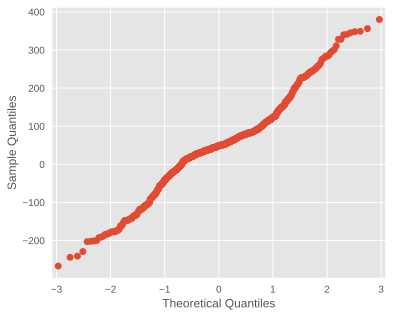

In [ ]:
residual = np.array(errors)
qqplot(residual)
plt.show()

Check weather the resid. disrtibution is Laplace or normal:

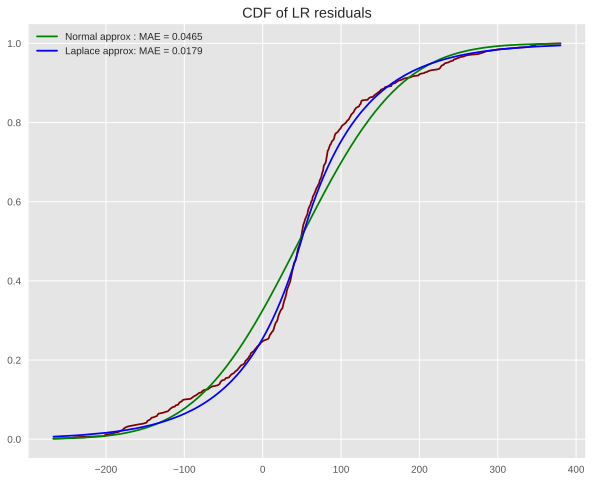

2.5952541818619843


In [ ]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)
resid_arr

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of LR residuals")
plt.show()
print(mae_norm/mae_laplace)


Errors have Laplace distribution. MAE metric proofs it

### **Metrics**

**Errors on the train**

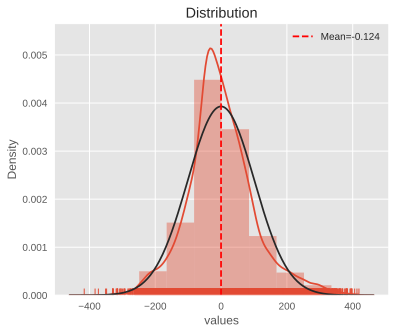

In [ ]:
error = train_label - lr_model.predict(trainData)
draw_histogram(error)

* We see that the distribution is not similar to the normal one - it is a little bit assumetrical, but it has an average expectation of zero. This is exactly what we assumed as the noise distribution.

In [ ]:
calc_metrics(train_label, lr_model.predict(trainData), lr_model, trainData, train_label)

*** VAL **: 
MSE:   10309.51445864156
RMSE:  101.5357792043847
R2:    0.5711947762978125
MAE:   76.06025554808339
MedAE: 56.0
------------------------------


**Errors on the test**

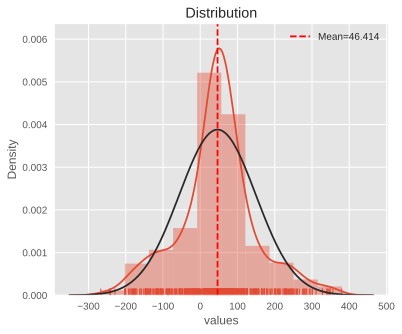

In [ ]:
error = test_label - pred
draw_histogram(error)

In [ ]:
calc_metrics(test_label, pred, lr_model, testData, test_label)

*** VAL **: 
MSE:   12724.290854572713
RMSE:  112.80199845114764
R2:    0.44056398244099904
MAE:   87.73013493253373
MedAE: 68.0
------------------------------


* It can be seen that the variance turned out to be larger on the test, but not much.

## **Hyperparameters tuning**

Selection of optimal hyperparameters for cross-validation

In [ ]:
params = [
    {
        'n_jobs': [i for i in range(-1, 50, 3)],
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
lr_model = LinearRegression()

cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(lr_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_absolute_error', 'r2'], 
                  refit='neg_mean_absolute_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainData,train_label);

CPU times: user 1.22 s, sys: 171 ms, total: 1.39 s
Wall time: 11.4 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=LinearRegression(copy_X=True, fit_intercept=True,
                                        n_jobs=None, normalize=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'n_jobs': [-1, 2, 5, 8, 11, 14, 17, 20, 23, 26, 29,
                                     32, 35, 38, 41, 44, 47],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_absolute_error',
             return_train_score=False,
             scoring=['neg_mean_absolute_error', 'r2'], verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': False, 'n_jobs': -1, 'normalize': True}

Now we will train the model with the selected parameters

In [ ]:
lr_model =  LinearRegression(fit_intercept=False, n_jobs=-1, normalize=True)
lr_model.fit(trainData, train_label)

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=-1, normalize=True)

In [ ]:
pred = lr_model.predict(testData)

### **Look at feature importance**

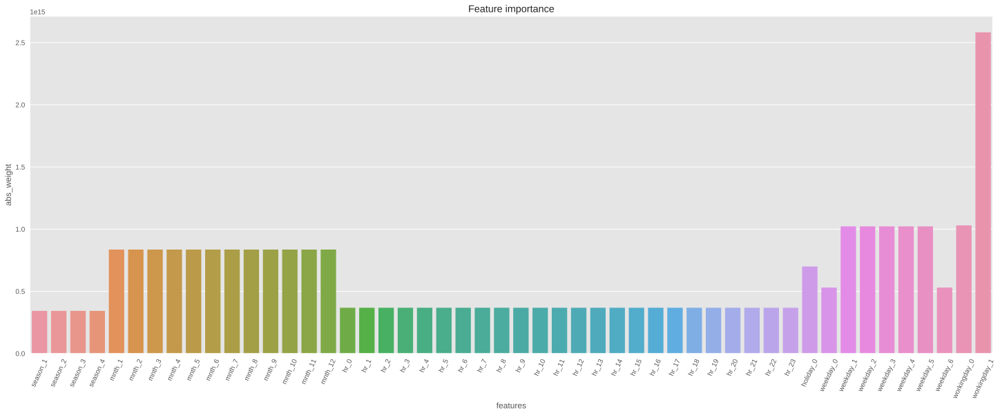

In [ ]:
get_feat_imp_coef(lr_model,trainData)

* In the tunned model, the biggest role is played by the fact that the day is a working day (in EDA, demand was high these days).

* Looking at the features and their importance for the model, it is quite logical to see among the important features: the days of the week and whether it is a working day or not, since in EDA it was revealed that from the day of the week and from whether it is a working day or not, the demand for bicycles also grows.


### **Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


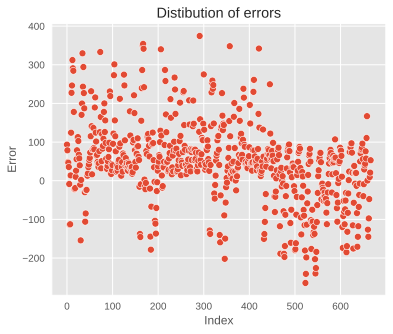

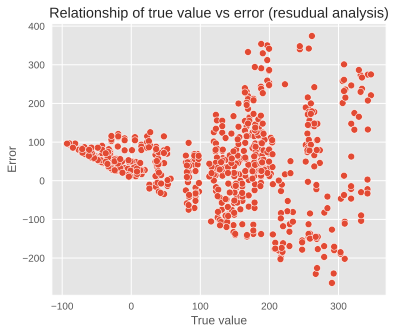

In [ ]:
errors = test_label - pred
draw_res_analys(errors, pred)

**Conclusion**
* The trend in the second figure is visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.


**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.7555854852328558), ('p-value', 0.9925184199925986)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

It is worth noting that the Laplace distribution is more suitable for these residuals.

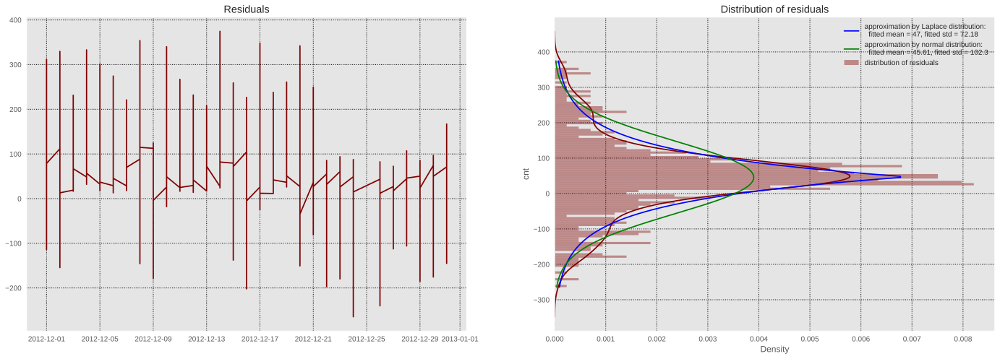

In [ ]:
draw_resid_decomposition(errors)

It is worth noting that the Laplace distribution is more suitable for these residuals.

**Residual Q-Q Plot**  

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.
* This plot shows that the distribution is seemingly normal with a few bumps and outliers.

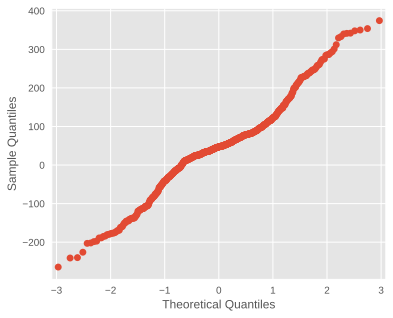

In [ ]:
residual = np.array(errors)
qqplot(residual)
plt.show()


Check weather the resid. disrtibution is Laplace or normal:

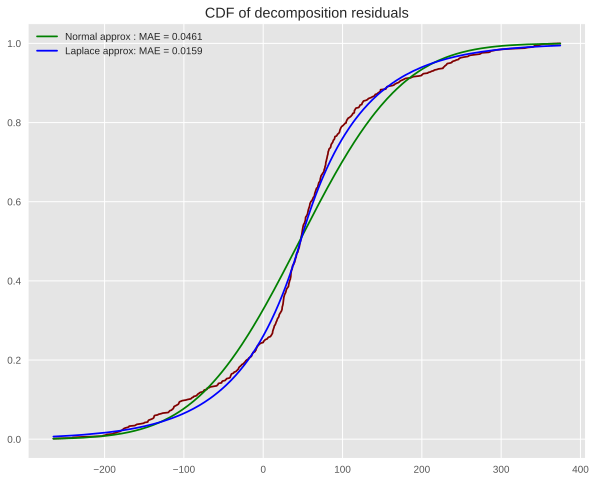

2.8961995488893275


In [ ]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)


loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)


Errors have Laplace distribution. MAE metric proofs it.

### **Metrics**

**Errors on the train**

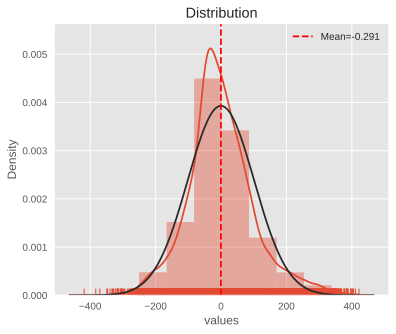

In [ ]:
error = train_label - lr_model.predict(trainData)
draw_histogram(error)

In [ ]:
calc_metrics(train_label, lr_model.predict(trainData), lr_model, trainData, train_label)

*** VAL **: 
MSE:   10306.221534549428
RMSE:  101.51956232445758
R2:    0.571331739397057
MAE:   76.02133490248823
MedAE: 56.0
------------------------------


**Errors on the test**

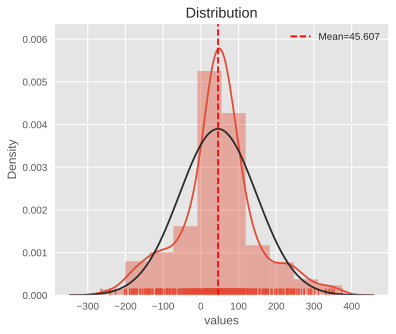

In [ ]:
error = test_label - pred
draw_histogram(error)

In [ ]:
calc_metrics(test_label, pred, lr_model, testData, test_label)

*** VAL **: 
MSE:   12546.676349325337
RMSE:  112.01194735083101
R2:    0.44837297962692835
MAE:   86.60944527736132
MedAE: 67.0
------------------------------


## **Conclusion**

* This model works well enough, the score has changed for the better after tuning (was: 87,7;  now: 86,6).  I think that an additional, more fine-tuning of the parameters is also needed.

* On the test (tune), *MAE: 86,6*.

* Of caurse, the result is close from a good one.

* This model copes normaly with prediction.

# **Improved Linear Regression**

Improve your baseline model using results of target decomposition and exogenous features.

## **Simple model**

In [ ]:
lr_model = LinearRegression()
lr_model.fit(trainDataExog, train_label_exog)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
pred = lr_model.predict(testDataExog)

### **Look at feature importance**

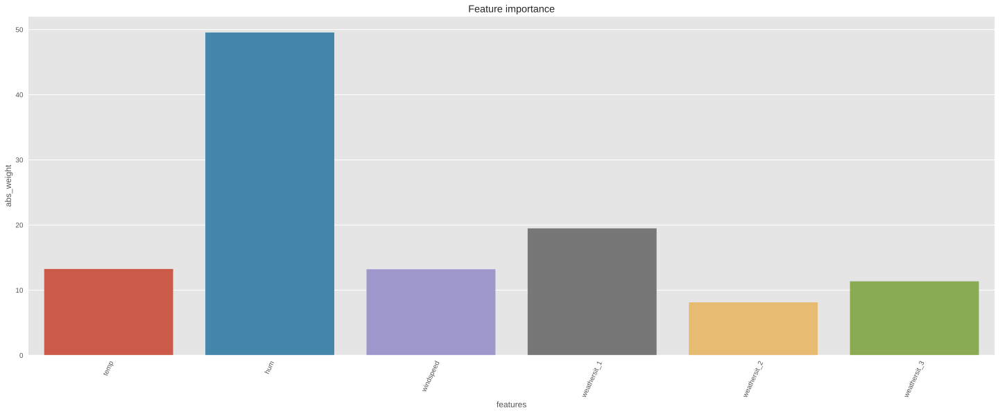

In [ ]:
get_feat_imp_coef(lr_model, trainDataExog)

* Looking at the features and their importance for the model, humidity playes an important role here.


### **Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


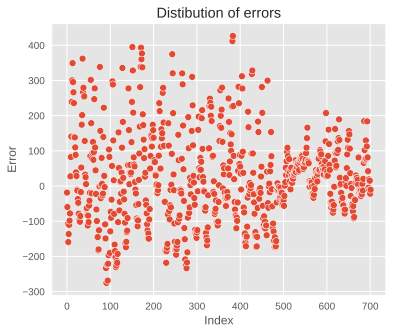

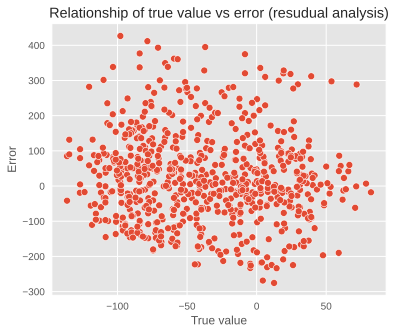

In [ ]:
errors = test_label_exog - pred

draw_res_analys(errors, pred) 

**Conclusion**
* There no obvious trend on plot. Lets take a look on test statistics.

**Now I will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.  

**Goldfeld Quandt Test**   
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testDataExog)

[('F statistic', 0.4434858013169476), ('p-value', 0.9999999999999517)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

It is worth noting that the Laplace distribution is more suitable for these residuals.

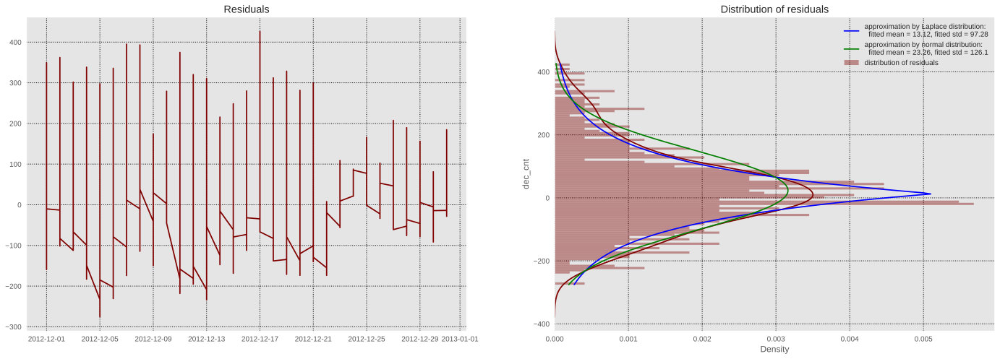

In [ ]:
draw_resid_decomposition(errors)

It is worth noting that the Laplace distribution is more suitable for these residuals.

**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.
* This plot shows that the distribution is seemingly normal with a few bumps and outliers.

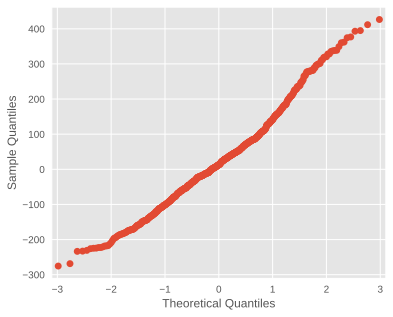

In [ ]:
residual = np.array(errors)
qqplot(residual)
plt.show()

Check weather the resid. disrtibution is Laplace or normal:

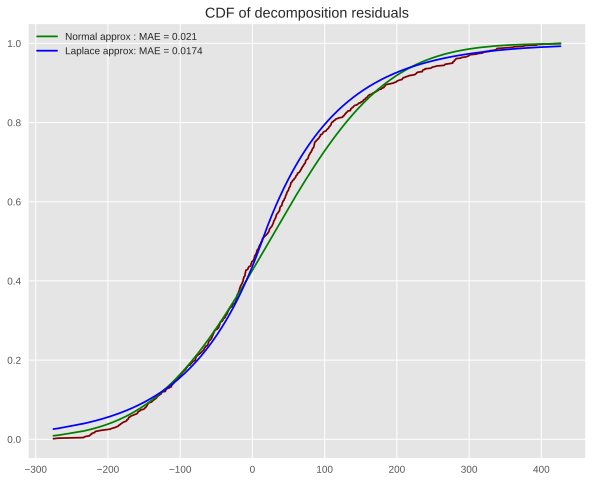

1.2018940328395593


In [ ]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

### **Metrics**

**Errors on the train**

In [ ]:
error = train_label_exog - lr_model.predict(trainDataExog)
draw_histogram(error)

Output hidden; open in https://colab.research.google.com to view.

* We see that the distribution is not similar to the normal one - it is a little bit assumetrical, but it has an average expectation of zero. This is exactly what we assumed as the noise distribution.

In [ ]:
calc_metrics(train_label_exog, lr_model.predict(trainDataExog), lr_model,trainDataExog, train_label_exog)

*** VAL **: 
MSE:   17382.12643356126
RMSE:  131.84129259667193
R2:    0.14095880768630786
MAE:   102.86817910814833
MedAE: 81.92897863271082
------------------------------


**Errors on the test**

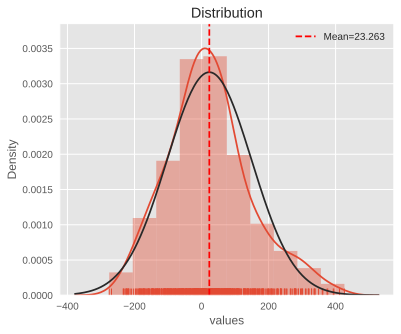

In [ ]:
error = test_label_exog - pred
draw_histogram(error)

In [ ]:
calc_metrics(test_label_exog, pred, lr_model, testDataExog, test_label_exog)

*** VAL **: 
MSE:   16451.62994829445
RMSE:  128.2639074264247
R2:    0.047352817331711816
MAE:   97.95557545001951
MedAE: 77.0932344306037
------------------------------


## **Hyperparameters tuning**

Selection of optimal hyperparameters for cross-validation

In [ ]:
params = [
    {
        'n_jobs': [i for i in range(-1, 50, 3)],
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
lr_model = LinearRegression()

cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(lr_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_absolute_error', 'r2'], 
                  refit='neg_mean_absolute_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainDataExog,train_label_exog);

CPU times: user 720 ms, sys: 65.1 ms, total: 785 ms
Wall time: 2.59 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=LinearRegression(copy_X=True, fit_intercept=True,
                                        n_jobs=None, normalize=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'n_jobs': [-1, 2, 5, 8, 11, 14, 17, 20, 23, 26, 29,
                                     32, 35, 38, 41, 44, 47],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_absolute_error',
             return_train_score=False,
             scoring=['neg_mean_absolute_error', 'r2'], verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': True, 'n_jobs': -1, 'normalize': True}

Now we will train the model with the selected parameters

In [ ]:
lr_model = LinearRegression(fit_intercept=True, n_jobs=-1, normalize=True)
lr_model.fit(trainDataExog, train_label_exog)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=True)

In [ ]:
pred = lr_model.predict(testDataExog)

### **Look at feature importance**

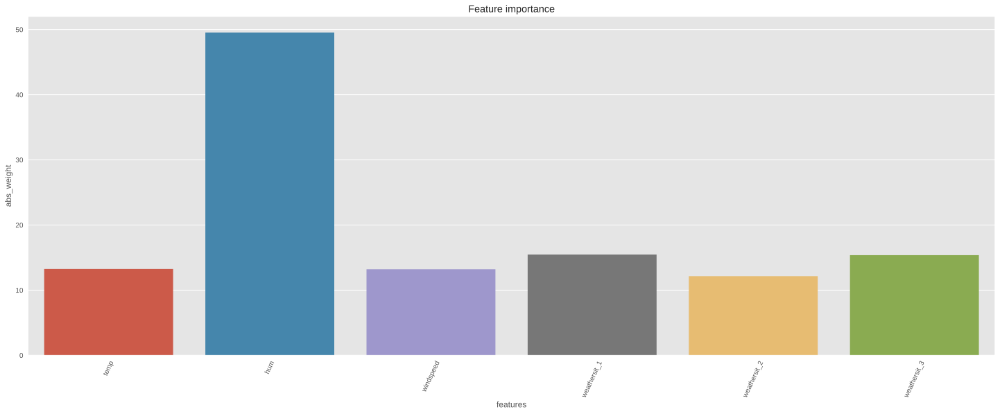

In [ ]:
get_feat_imp_coef(lr_model,trainDataExog)

* Looking at the features and their importance for the model, humidity playes an important role here.


### **Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


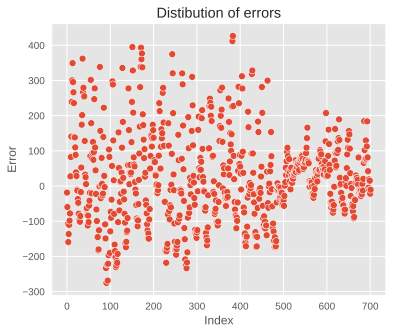

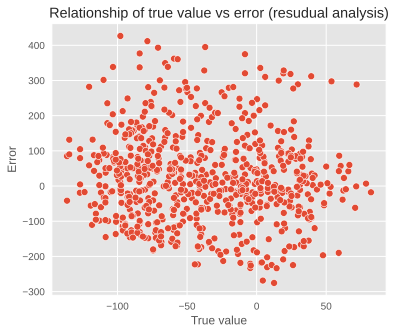

In [ ]:
errors = test_label_exog - pred
draw_res_analys(errors, pred)

**Conclusion**
* There is no trend on plot, lets take a look on test statistics.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.


**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testDataExog)

[('F statistic', 0.4434858013169476), ('p-value', 0.9999999999999517)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

It is worth noting that the Laplace distribution is more suitable for these residuals.

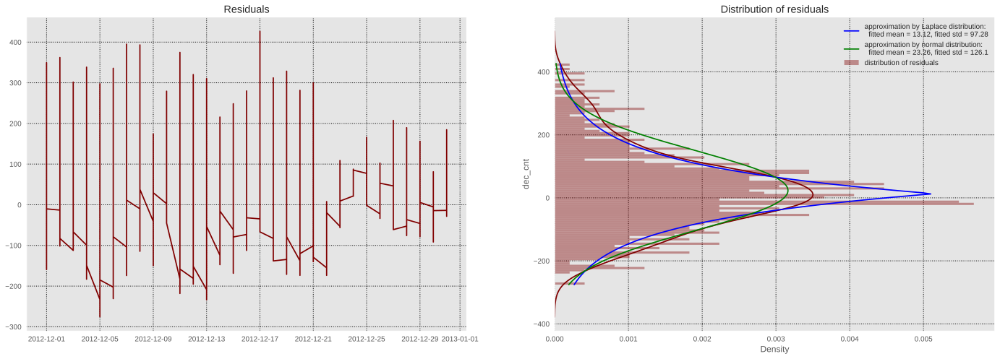

In [ ]:
draw_resid_decomposition(errors)

* It is worth noting that the Laplace distribution is more suitable for these residuals.



**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.
* This plot shows that the distribution is seemingly normal with a few bumps and outliers.

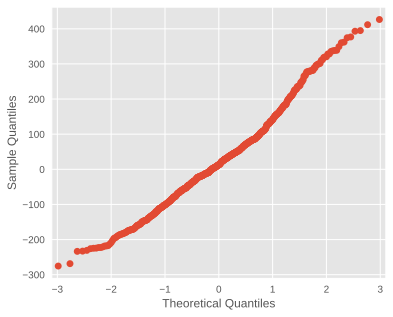

In [ ]:
residual = np.array(errors)
qqplot(residual)
plt.show()

Check weather the resid. disrtibution is Laplace or normal:

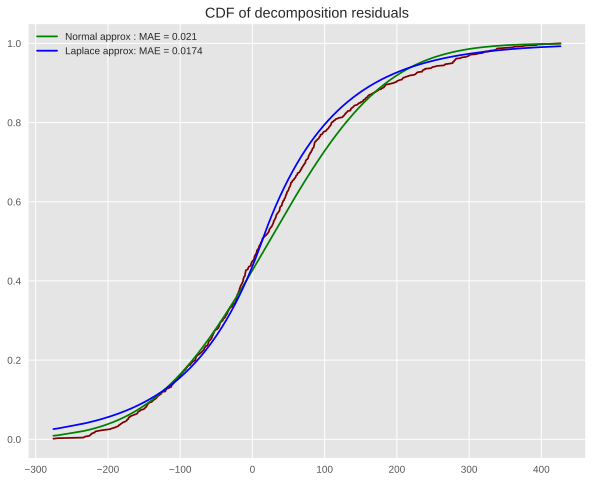

1.2019047226432529


In [ ]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

### **Metrics**

**Errors on the train**

In [ ]:
error = train_label_exog - lr_model.predict(trainDataExog)
draw_histogram(error)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
calc_metrics(train_label_exog, lr_model.predict(trainDataExog), lr_model, trainDataExog, train_label_exog)

*** VAL **: 
MSE:   17382.12643356126
RMSE:  131.84129259667193
R2:    0.14095880768630786
MAE:   102.86817910814831
MedAE: 81.92897863271085
------------------------------


**Errors on the test**

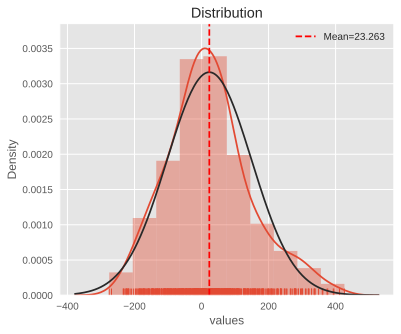

In [ ]:
error = test_label_exog - pred
draw_histogram(error)

In [ ]:
calc_metrics(test_label_exog, pred, lr_model, testDataExog, test_label_exog)

*** VAL **: 
MSE:   16451.62994829445
RMSE:  128.2639074264247
R2:    0.047352817331711816
MAE:   97.95557545001952
MedAE: 77.09323443060387
------------------------------


## **Conclusion**

* This model works worth than the prev. one (was MAE: 86,6  ;  now MAE: 97.9)

* This model works good enough, but tunning of hyperparams doesn't help in this situation, the score has changed by one ten-thousandth, I think that an additional, more fine-tuning of the parameters is needed.

* On the test, *MAE: 97,9*.

* Of caurse, the result is close from a good one.

* This model copes normaly with prediction.


# **ARIMA model**

### **Splitting ( usage of decomposed target)**

In [ ]:
ts_moving_avg_diff.dropna(inplace=True)

In [ ]:
trainData_ar = ts_moving_avg_diff['2011-01':'2012-11']
trainData_ar.head()

dteday
2011-01-01    -2.041667
2011-01-02   -24.083333
2011-01-02   -23.125000
2011-01-02   -30.166667
2011-01-02   -32.875000
Name: cnt, dtype: float64

In [ ]:
trainData_ar.head(3)

dteday
2011-01-01    -2.041667
2011-01-02   -24.083333
2011-01-02   -23.125000
Name: cnt, dtype: float64

In [ ]:
testData_ar = ts_moving_avg_diff['2012-12']
testData_ar.head()

dteday
2012-12-01   -130.500000
2012-12-01   -171.583333
2012-12-01   -192.166667
2012-12-01   -227.625000
2012-12-01   -237.708333
Name: cnt, dtype: float64

In [ ]:
N_test = 742
print(f"we have {len(ts_moving_avg_diff)} points totally and last {N_test} test points amongst them.")

train_ind = np.arange(len(ts_moving_avg_diff)-N_test)
test_ind = np.arange(len(ts_moving_avg_diff)-N_test, len(ts_moving_avg_diff))

we have 17356 points totally and last 742 test points amongst them.


**Forecasting a Time Series**  

* I use are moving average method to avoid trend and seasonality problem.

* Also prediction method is ARIMA that is Auto-Regressive Integrated Moving Averages.

  * **AR**: Auto-Regressive (p): AR terms are just lags of dependent variable. For example lets say p is 3, we will use x(t-1), x(t-2) and x(t-3) to predict x(t)

  * **I**: Integrated (d): These are the number of nonseasonal differences. For example, in our case we take the first order difference. So we pass that variable and put d=0

  * **MA**: Moving Averages (q): MA terms are lagged forecast errors in prediction equation.

* **(p,d,q)** is parameters of ARIMA model.

* In order to choose p,d,q parameters I will use two different plots.

  * **Autocorrelation Function** (ACF): Measurement of the correlation between time series and lagged version of time series.

  * **Partial Autocorrelation Function** (PACF): This measures the correlation between the time series and lagged version of time series but after eliminating the variations already explained by the intervening comparisons.

### **Choose p,d,q**

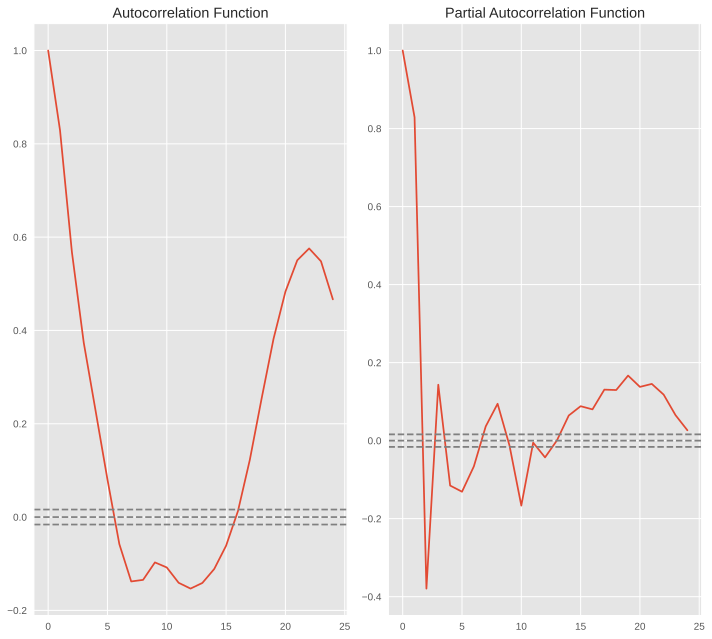

In [ ]:
# ACF and PACF 
from statsmodels.tsa.stattools import acf, pacf
lag_acf = acf(train_label, nlags=24)
lag_pacf = pacf(train_label, nlags=24, method='ols')
# ACF
plt.figure(figsize=(10,9))

plt.subplot(121) 
plt.plot(lag_acf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(train_label)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(train_label)),linestyle='--',color='gray')
plt.title('Autocorrelation Function')

# PACF
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(train_label)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(train_label)),linestyle='--',color='gray')
plt.title('Partial Autocorrelation Function')
plt.tight_layout()

* Two dotted lines are the confidence interevals. We use these lines to determine the ‘p’ and ‘q’ values
  * *Choosing p*: The lag value where the PACF chart crosses the upper confidence interval for the first time. p=1.
  * *Choosing q*: The lag value where the ACF chart crosses the upper confidence interval for the first time. q=1.
* Now lets use (2,0,7) as parameters of ARIMA models and predict.

### **Model**

In [ ]:
p, d, q =  2, 0, 7

arima_model = ARIMA(trainData_ar, order=(p, d, q)).fit()
# Forecast
print()
print(f"ARIMA model ({p}, {d}, {q}):")
print(arima_model.params)

prediction_arima_train = arima_model.predict(trainData_ar.index[0], trainData_ar.index[-1])
prediction_arima_test = arima_model.predict(test_ind[0], test_ind[-1])

mae_arima = mean_absolute_error(y_true=testData_ar, y_pred=prediction_arima_test)



ARIMA model (2, 0, 7):
const        0.018684
ar.L1        1.930506
ar.L2       -0.998620
ma.L1       -0.873462
ma.L2       -0.511432
ma.L3        0.110533
ma.L4        0.273233
ma.L5        0.205775
ma.L6        0.016647
ma.L7       -0.066347
sigma2    6421.258962
dtype: float64


In [ ]:
print(arima_model.summary())

                               SARIMAX Results                                
Dep. Variable:                    cnt   No. Observations:                16614
Model:                 ARIMA(2, 0, 7)   Log Likelihood              -96040.544
Date:                Wed, 06 Oct 2021   AIC                         192103.087
Time:                        16:27:02   BIC                         192187.985
Sample:                             0   HQIC                        192131.115
                              - 16614                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0187      2.427      0.008      0.994      -4.737       4.775
ar.L1          1.9305      0.000   5693.584      0.000       1.930       1.931
ar.L2         -0.9986      0.000  -2572.692      0.0

* A brief description of the model reveals a lot of information. The table in the middle is a table of coefficients, where the values under "coef" are the weights of the corresponding terms.

* Almost all P values in the 'P>|z|' column are less than 0.05 so that the corresponding X is significant.

**Lets take a look at prediction:**

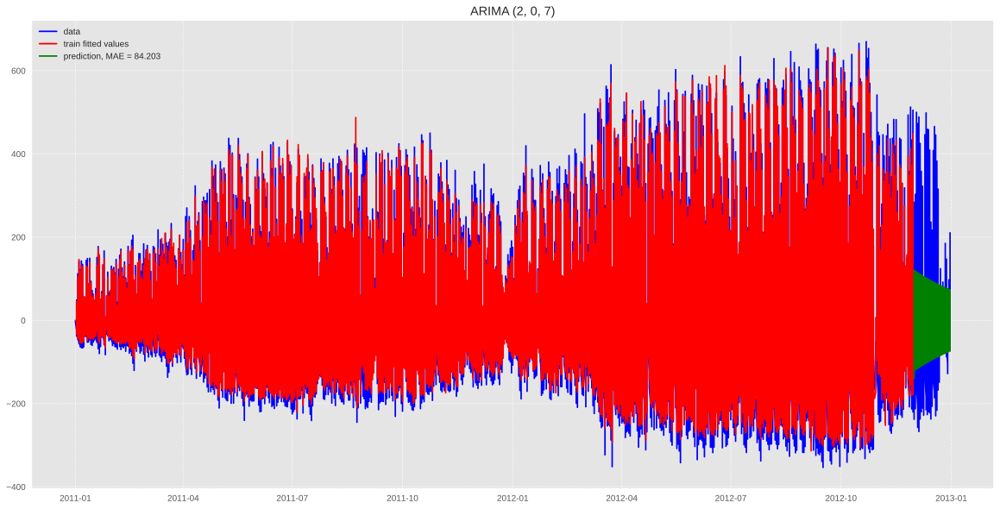

In [ ]:
plt.figure(figsize=(20,10))
plt.plot(ts_moving_avg_diff.index, ts_moving_avg_diff, '-b', label="data")
plt.plot(arima_model.fittedvalues, '-r', label="train fitted values")
plt.plot(testData_ar.index, prediction_arima_test, '-g', label=f"prediction, MAE = {mae_arima:0.3f}")
plt.grid(linestyle=':')
plt.legend()
plt.title(f"ARIMA {(p, d, q)}")
plt.show()

### **Residuals**

Let's draw the residuals to make sure there are no patterns (that is, look for a constant mean and variance).

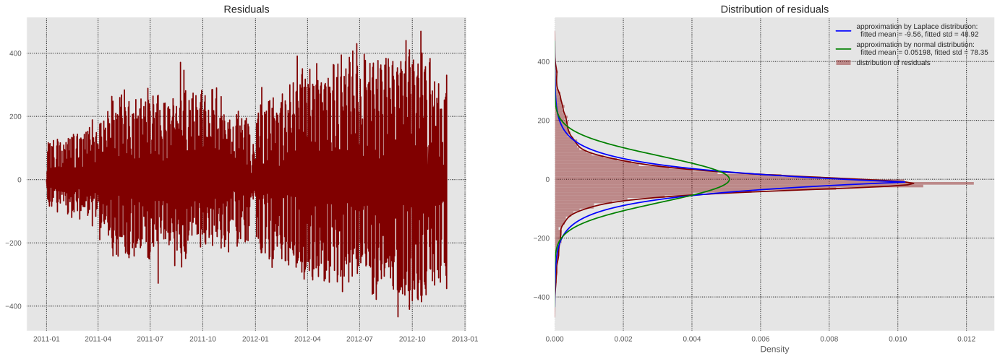

In [ ]:
draw_resid_decomposition(arima_model.resid)

* It is worth noting that the Laplace distribution is more suitable for these residuals.

**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.


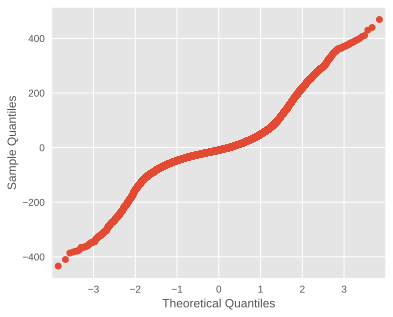

In [ ]:
residual = np.array(arima_model.resid)
qqplot(residual)
plt.show()

* This plot shows that the distribution is not normal with a few bumps and outliers. Model is nos to good.

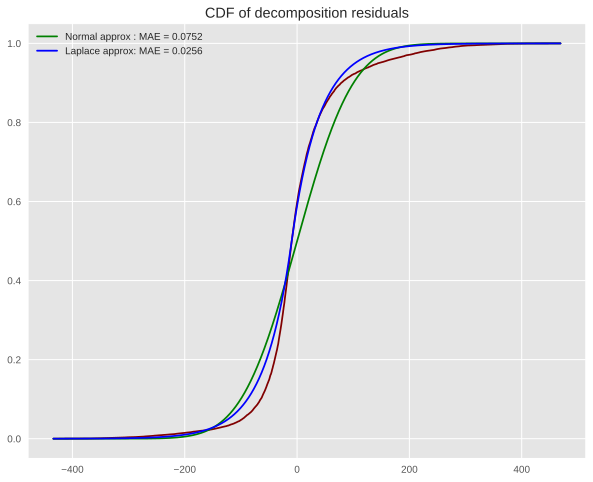

2.9343142665000252


In [ ]:
errors = arima_model.resid

ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

<Figure size 720x720 with 0 Axes>

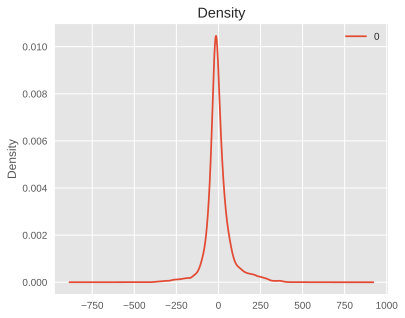

In [ ]:
plt.figure(figsize=(10,10))
residuals = pd.DataFrame(arima_model.resid)
residuals.plot(kind='kde', title='Density')
plt.show()

It seems to me, that the residual errors seem to be good with a near-zero mean and uniform variance.

### **Auto Arima Forecast**

auto_arima() uses a stepwise approach to search multiple combinations of p,d,q parameters and chooses the best model that has the least AIC.

In [ ]:
import pmdarima as pm


model = pm.auto_arima(trainData_ar, start_p=1, start_q=6,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=5, max_q=9, # maximum p and q
                      m=1,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=False,   # No Seasonality
                      start_P=0, 
                      D=0, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True)

print(model.summary())

Performing stepwise search to minimize aic
 ARIMA(1,0,6)(0,0,0)[0]             : AIC=inf, Time=21.53 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=216910.211, Time=0.34 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=198888.968, Time=0.42 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=202023.875, Time=1.75 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=195349.867, Time=0.64 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=194999.997, Time=0.83 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=194743.230, Time=0.99 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=194282.490, Time=1.29 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=192889.045, Time=13.46 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=192913.925, Time=16.11 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=192842.172, Time=22.50 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=194294.611, Time=14.79 sec
 ARIMA(5,0,3)(0,0,0)[0]             : AIC=inf, Time=24.17 sec
 ARIMA(4,0,3)(0,0,0)[0]             : AIC=193030.494, Time=19.24 sec
 ARIMA(5,0,2

Let’s review the residual plots.

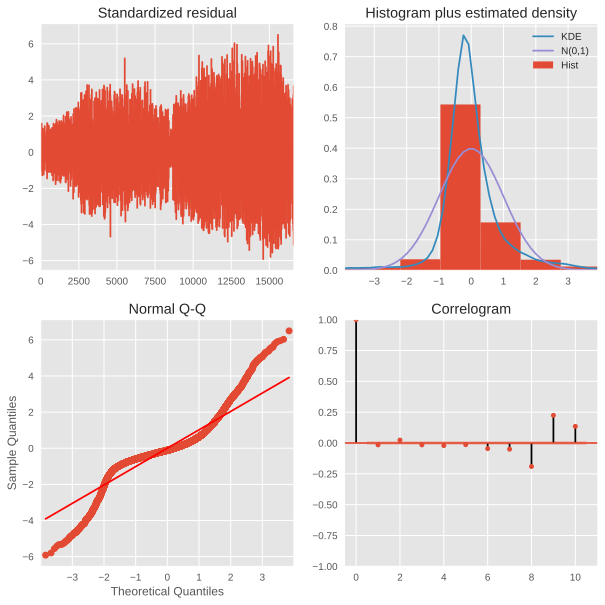

In [ ]:
model.plot_diagnostics(figsize=(10,10))
plt.show()

**Conclusion**  

**Top left:** residual errors fluctuate significantly above and below the zero mean and do not have uniform variance.

**Top right**: The density graph assumes a larger Laplace distribution.

**Bottom left:** all points must exactly match the red line. Any significant deviations mean that the distribution is distorted.

**Bottom right:** The correlogram graph, aka ACF, shows that the residual errors are not autocorrelated. Any autocorrelation will mean that there is some pattern in residual errors that is not explained in the model. Therefore, you will need to look for more X (predictors) of the model.

## **Conclusion**

* This model works better than the prev. one (was MAE: 86,6  ;  now MAE: 84.2)

* On the test, *MAE: 84,2*.

* Of caurse, the result is close from a good one.

* This model copes good with prediction.


# **Additional**

Try use Prophet and/or SARIMAX.

## **SARIMA**

* The problem with plain ARIMA model is it does not support seasonality.

* If our time series has defined seasonality, then, go for SARIMA which uses seasonal differencing.

* Seasonal differencing is similar to regular differencing, but, instead of subtracting consecutive terms, you subtract the value from previous season.

* So, the model will be represented as SARIMA(p,d,q)x(P,D,Q), where, P, D and Q are SAR, order of seasonal differencing and SMA terms respectively and 'x' is the frequency of the time series.

* If our model has well defined seasonal patterns, then enforce D=1 for a given frequency ‘x’.


In [136]:
import statsmodels.tsa.api as smt

In [271]:
def tsplot(y, lags=None, figsize=(12, 7), style='bmh'):
    """
        Plot time series, its ACF and PACF, calculate Dickey–Fuller test
        
        y - timeseries
        lags - how many lags to include in ACF, PACF calculation
    """
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
        
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        layout = (2, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        
        y.plot(ax=ts_ax)
        p_value = sm.tsa.stattools.adfuller(y)[1]
        ts_ax.set_title('Time Series Analysis Plots\n Dickey-Fuller: p={0:.5f}'.format(p_value))
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax)
        plt.tight_layout()

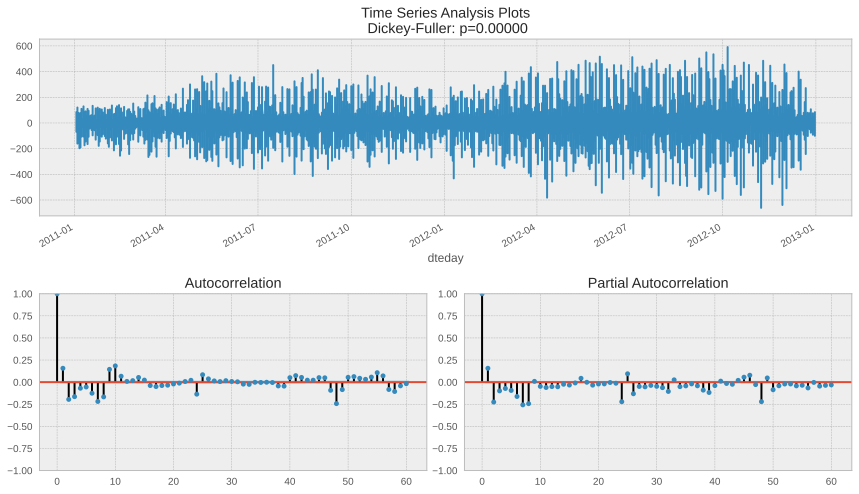

In [276]:
ts_moving_avg_diff.dropna(inplace=True)

ads_diff = ts_moving_avg_diff - ts_moving_avg_diff.shift(24)
ads_diff = ads_diff - ads_diff.shift(1)
tsplot(ads_diff[24+1:], lags=60)

This series now looks like something undescribable, oscillating around zero. The Dickey-Fuller test indicates that it is stationary, and the number of significant peaks in ACF has dropped. 

* p  is most probably 7 since it is the last significant lag on the PACF, after which, most others are not significant.
* d  equals 1 because we had first differences
* q  should be somewhere around 7 as well as seen on the ACF
* P  might be 2, since 24-th and 48-th lags are somewhat significant on the PACF
* D  again equals 1 because we performed seasonal differentiation
* Q  is probably 1. The 24-th lag on ACF is significant while the 48-th is not.

Let's test various models and see which one is better.

In [277]:
import statsmodels.api as sm
import itertools

In [278]:
# setting initial values and some bounds for them
from itertools import product   
ps = range(2, 8)
d=1 
qs = range(2, 8)
Ps = range(0, 2)
D=1 
Qs = range(0, 2)
s = 24 # season length is still 24

# creating list with all the possible combinations of parameters
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

144

In [282]:
def optimizeSARIMA(parameters_list, d, D, s):
    """
        Return dataframe with parameters and corresponding AIC
        
        parameters_list - list with (p, q, P, Q) tuples
        d - integration order in ARIMA model
        D - seasonal integration order 
        s - length of season
    """
    
    results = []
    best_aic = float("inf")

    for param in tqdm_notebook(parameters_list):
        # we need try-except because on some combinations model fails to converge
        try:
            model=sm.tsa.statespace.SARIMAX(trainData_ar, order=(param[0], d, param[1]), 
                                            seasonal_order=(param[2], D, param[3], s)).fit(disp=-1)
        except:
            continue
        aic = model.aic
        # saving best model, AIC and parameters
        if aic < best_aic:
            best_model = model
            best_aic = aic
            best_param = param
        results.append([param, model.aic])

    result_table = pd.DataFrame(results)
    result_table.columns = ['parameters', 'aic']
    # sorting in ascending order, the lower AIC is - the better
    result_table = result_table.sort_values(by='aic', ascending=True).reset_index(drop=True)
    
    return result_table

In [ ]:
from tqdm import tqdm_notebook

result_table = optimizeSARIMA(parameters_list, d, D, s)

![picture](https://drive.google.com/uc?export=view&id=1PGmQVWI4zOBN_RVSQvKdI5dpqO1vEgZ7)

You can see the picture above.
I was tring to work with model but there were not enough resouses. );

In [ ]:
# result_table.head()

In [ ]:
# # set the parameters that give the lowest AIC
# p, q, P, Q = result_table.parameters[0]

# best_model=sm.tsa.statespace.SARIMAX(ads.Ads, order=(p, d, q), 
#                                         seasonal_order=(P, D, Q, s)).fit(disp=-1)
# print(best_model.summary())

Let's inspect the residuals of the model.

In [ ]:
# tsplot(best_model.resid[24+1:], lags=60)

In [285]:
# def plotSARIMA(series, model, n_steps):
#     """
#         Plots model vs predicted values
        
#         series - dataset with timeseries
#         model - fitted SARIMA model
#         n_steps - number of steps to predict in the future
        
#     """
#     # adding model values
#     data = series.copy()
#     data.columns = ['actual']
#     data['arima_model'] = model.fittedvalues
#     # making a shift on s+d steps, because these values were unobserved by the model
#     # due to the differentiating
#     data['arima_model'][:s+d] = np.NaN
    
#     # forecasting on n_steps forward 
#     forecast = model.predict(start = data.shape[0], end = data.shape[0]+n_steps)
#     forecast = data.arima_model.append(forecast)
#     # calculate error, again having shifted on s+d steps from the beginning
#     error = mean_absolute_percentage_error(data['actual'][s+d:], data['arima_model'][s+d:])

#     plt.figure(figsize=(15, 7))
#     plt.title("Mean Absolute Percentage Error: {0:.2f}%".format(error))
#     plt.plot(forecast, color='r', label="model")
#     plt.axvspan(data.index[-1], forecast.index[-1], alpha=0.5, color='lightgrey')
#     plt.plot(data.actual, label="actual")
#     plt.legend()
#     plt.grid(True);

In [ ]:
# plotSARIMA(ts_moving_avg_diff, best_model, 50)

## **Prophet**

* For this model the first column must have the name ‘ds‘ and contain the date-times. The second column must have the name ‘y‘ and contain the observations.

This means we change the column names in the dataset. It also requires that the first column be converted to date-time objects.




### **Split**

In [ ]:
trainData_ar = trainData_ar.to_frame()

In [ ]:
trainData_pr = trainData_ar.rename(columns = {'cnt': 'y'}, inplace = False)
trainData_pr.index.names = ['ds']

In [ ]:
trainData_pr.reset_index(inplace=True)

In [ ]:
trainData_pr['ds']= pd.to_datetime(trainData_pr['ds'])

In [ ]:
trainData_pr.head()

,ds,y
0,2011-01-01,-2.041667
1,2011-01-02,-24.083333
2,2011-01-02,-23.125000
3,2011-01-02,-30.166667
4,2011-01-02,-32.875000


In [ ]:
testData_ar = testData_ar.to_frame()
testData_pr = testData_ar.rename(columns = {'cnt': 'y'}, inplace = False)
testData_pr.index.names = ['ds']

In [ ]:
testData_pr.reset_index(inplace=True)
testData_pr['ds']= pd.to_datetime(testData_pr['ds'])

In [ ]:
testData_pr.head()

,ds,y
0,2012-12-01,-130.500000
1,2012-12-01,-171.583333
2,2012-12-01,-192.166667
3,2012-12-01,-227.625000
4,2012-12-01,-237.708333


### **Model**

In [ ]:
from fbprophet import Prophet

In [ ]:
# Setup and train model and fit
model = Prophet()
model.fit(trainData_pr)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
# Predict on training set with model
test_fcst = model.predict(df=testData_pr)

In [ ]:
test_fcst.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2012-12-01,-0.028262,-210.024989,208.674258,-0.028262,-0.028262,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,0.0,0.0,0.0,-1.766555
1,2012-12-01,-0.028262,-199.664722,209.280758,-0.028262,-0.028262,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,0.0,0.0,0.0,-1.766555
2,2012-12-01,-0.028262,-220.649671,221.442112,-0.028262,-0.028262,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,0.0,0.0,0.0,-1.766555
3,2012-12-01,-0.028262,-216.408891,228.300711,-0.028262,-0.028262,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,0.0,0.0,0.0,-1.766555
4,2012-12-01,-0.028262,-233.601754,197.578615,-0.028262,-0.028262,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,-1.738293,0.0,0.0,0.0,-1.766555


Prophet returns a large DataFrame with many interesting columns, but I subset the output to the columns most relevant to forecasting. These are:

* **ds**: the datestamp of the forecasted value
* **yhat**: the forecasted value of our metric (in Statistics, yhat is a notation traditionally used to represent the predicted values of a value y)
* **yhat_lower**: the lower bound of our forecasts
* **yhat_upper**: the upper bound of our forecasts

* A variation in values from the output presented is to be expected as Prophet relies on Markov chain Monte Carlo (MCMC) methods to generate its forecasts.

* MCMC is a stochastic process, so values will be slightly different each time.

* Prophet also provides a convenient function to quickly plot the results of our forecasts as follows:

**Compare Forecast to Actuals**

MAE: 112.850


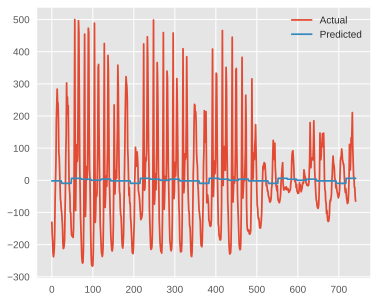

In [ ]:
y_true = testData_pr['y'].values
y_pred = test_fcst['yhat'].values
mae = mean_absolute_error(y_true, y_pred)
print('MAE: %.3f' % mae)
# plot expected vs actual
plt.plot(y_true, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.legend()
plt.show()

* Looking at *MAE*, it has a not so bad score, but it is lower than in other models.

In [ ]:
model.plot(test_fcst, uncertainty=True)

Output hidden; open in https://colab.research.google.com to view.

* Prophet plots the observed values of our time series (the black dots), the forecasted values (blue line) and the uncertainty intervals of our forecasts (the blue shaded regions).

* One other particularly strong feature of Prophet is its ability to return the components of our forecasts.

* This can help reveal how daily, weekly and yearly patterns of the time series contribute to the overall forecasted values.

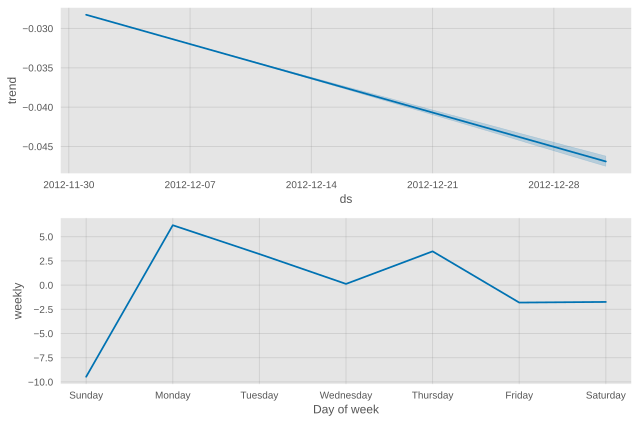

In [ ]:
# Plot the components of the model
fig = model.plot_components(test_fcst)

The above plot gives interesting ideas:

* The first graph shows that by the end of the month, the volume of demand for bicycles decreases linearly over time. (Holidays play a role)

* The second plot highlights the fact that the weekly number of passengers peaks at the beginning of the week and on Thursday.

### **Residuals**

In [ ]:
residuals =  test_fcst['yhat'] - testData_pr['y']

It is worth noting that the Laplace distribution is more suitable for these residuals.

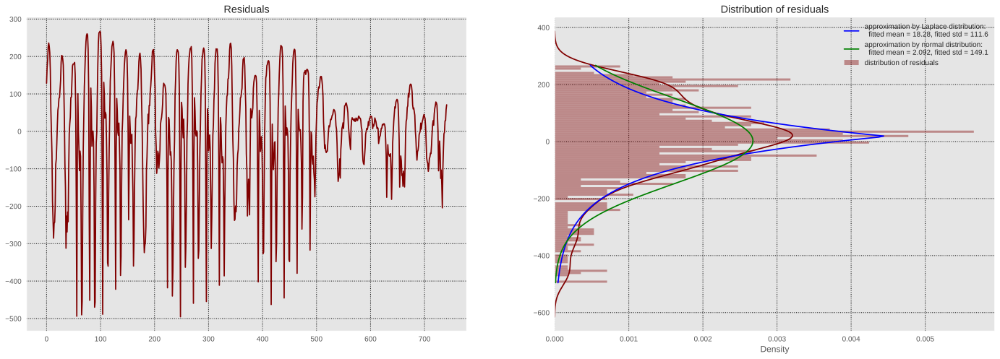

In [ ]:
draw_resid_decomposition(residuals)

**Residual Q-Q Plot**

* The Q-Q plot can be used to quickly check the normality of the distribution of residual errors.
* The values are ordered and compared to an idealized Gaussian distribution. The comparison is shown as a scatter plot (theoretical on the x-axis and observed on the y-axis) where a match between the two distributions is shown as a diagonal line from the bottom left to the top-right of the plot.
* The plot is helpful to spot obvious departures from this expectation.
* This plot shows that the distribution is seemingly normal with a few bumps and outliers.


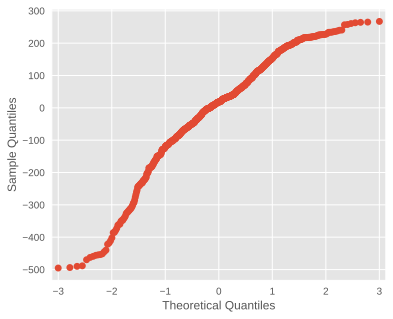

In [ ]:
residual = np.array(residuals)
qqplot(residual)
plt.show()

Check weather the resid. disrtibution is Laplace or normal:

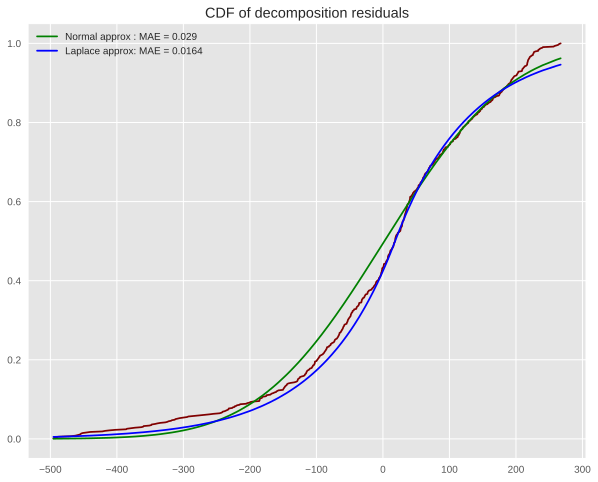

1.7663005792526874


In [ ]:
ecdf_resid_instance = ECDF(residuals.dropna())
resid_arr = residuals.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(residuals.dropna())
loc_norm, scale_norm = st.norm.fit(residuals.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

### **Conclusion**

* This model works worth than the prev. ones (was MAE: 86,6  or 97.9 ;  now MAE: 112,97)

* This model works not good enough, maybe tunning of params will help in this situation and clean data more. 

* On the test, *MAE: 112,97*.

* This model copes badly with prediction.


## **Boosting Regressor - XGBRegressor**

In [ ]:
import xgboost as xgb

### **Simple model**

In [296]:
xgbr_model = xgb.XGBRegressor(objective ='reg:squarederror') 
xgbr_model.fit(trainData, train_label)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

In [309]:
pred = xgbr_model.predict(testData)

**Look at feature importance**

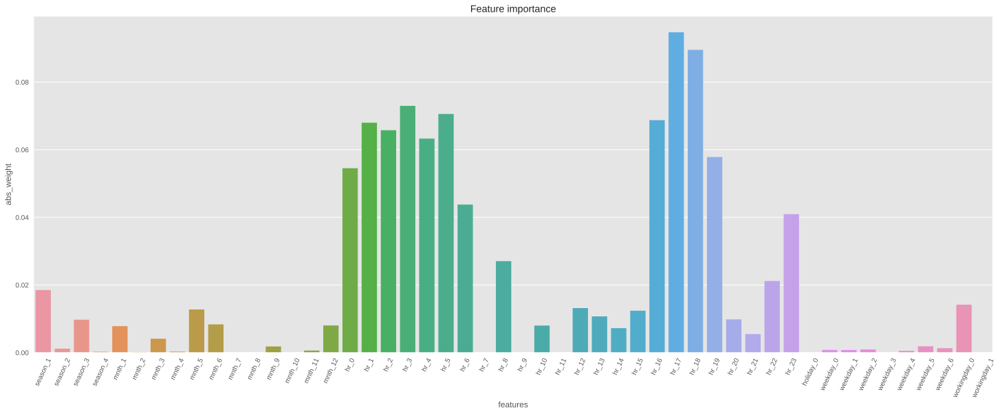

In [298]:
get_feature_importance(xgbr_model)

* Looking at the features and their importance for the model, it is quite logical to see among the important features: the hours, since in EDA it was revealed that the particular hours are very important.


**Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


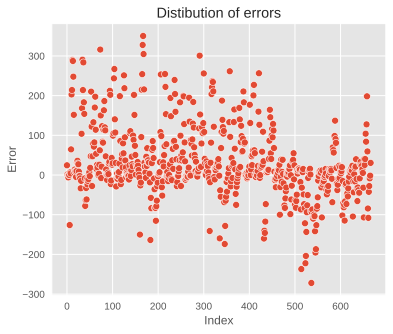

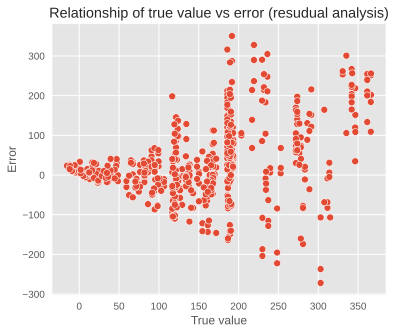

In [324]:
errors = test_label - pred
draw_res_analys(errors, pred) 

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now I will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.  

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [300]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.755532380189758), ('p-value', 0.992530979807761)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

It is worth noting that the Laplace distribution is more suitable for these residuals.

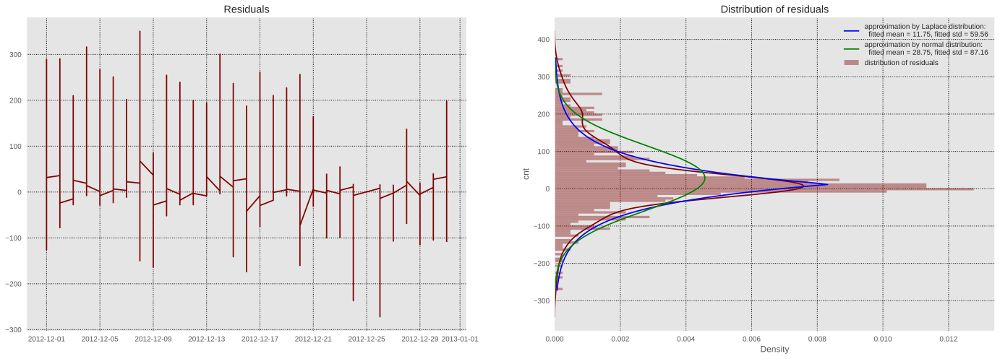

In [325]:
draw_resid_decomposition(errors)

It is worth noting that the Laplace distribution is more suitable for these residuals.

Check weather the resid. disrtibution is Laplace or normal:

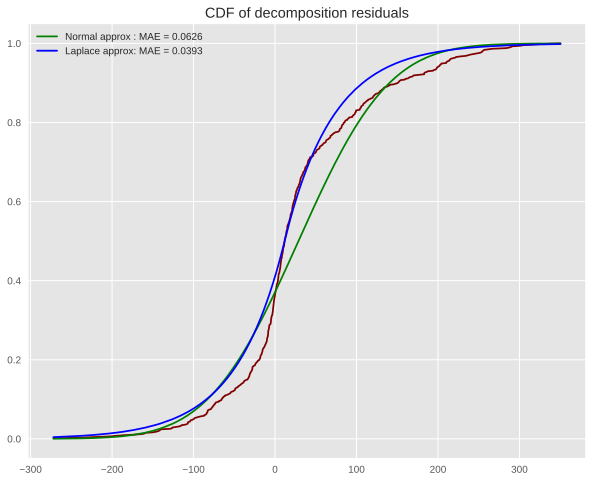

1.593785144831112


In [327]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

**Metrics**

**Errors on the train**

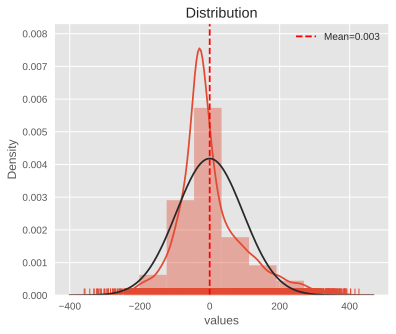

In [301]:
error = train_label - xgbr_model.predict(trainData)
draw_histogram(error)

* We see that the distribution is not similar to the normal one - it is a little bit assumetrical, but it has an average expectation of zero. This is exactly what we assumed as the noise distribution.

In [315]:
print('MAE - Train:   ', mean_absolute_error(train_label, xgbr_model.predict(trainData)))

MAE - Train:    69.60649024908705


**Errors on the test**

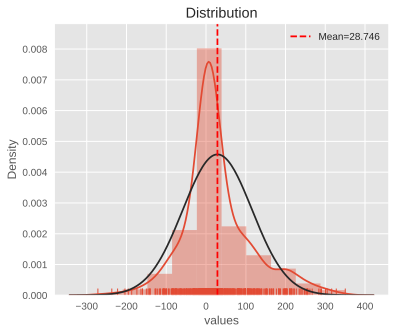

In [313]:
error = test_label - pred
draw_histogram(error)

In [314]:
print('MAE - Test:   ', mean_absolute_error(test_label, pred))

MAE - Test:    61.221237577419764


* It can be seen that the variance turned out to be larger on the test, but score is better.

### **Hyperparameters tuning**  
Selection of optimal hyperparameters for cross-validation

In [318]:
from sklearn.model_selection import RandomizedSearchCV

In [328]:
params = [
              {'nthread':[4], #when use hyperthread, xgboost may become slower
              'objective':['reg:squarederror'],
              'learning_rate': [.03, 0.05, .07],
              'max_depth': [5, 6, 7],
              'min_child_weight': [4],
              'silent': [1],
              'subsample': [0.7],
              'colsample_bytree': [0.7],
              'n_estimators': [500]}
        ]

In [329]:
xgbr_model = xgb.XGBRegressor() 

cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = RandomizedSearchCV(xgbr_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_absolute_error', 'r2'], 
                  refit='neg_mean_absolute_error', 
                  cv=cv)

In [330]:
%%time
gs.fit(trainData,train_label);

CPU times: user 31.2 s, sys: 1.14 s, total: 32.3 s
Wall time: 9min 21s


RandomizedSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
                   error_score=nan,
                   estimator=XGBRegressor(base_score=0.5, booster='gbtree',
                                          colsample_bylevel=1,
                                          colsample_bynode=1,
                                          colsample_bytree=1, gamma=0,
                                          importance_type='gain',
                                          learning_rate=0.1, max_delta_step=0,
                                          max_depth=3, min_child_weight=1,
                                          missing=None, n_estimators=100,
                                          n_jobs=1, nthread=None,
                                          obj...
                   param_distributions=[{'colsample_bytree': [0.7],
                                         'learning_rate': [0.03, 0.05, 0.07],
                                         'max_depth': [5, 6, 7],


In [331]:
gs.best_params_

{'colsample_bytree': 0.7,
 'learning_rate': 0.03,
 'max_depth': 6,
 'min_child_weight': 4,
 'n_estimators': 500,
 'nthread': 4,
 'objective': 'reg:squarederror',
 'silent': 1,
 'subsample': 0.7}

Now we will train the model with the selected parameters

In [332]:
xgbr_model = xgb.XGBRegressor(colsample_bytree=0.7,
                              learning_rate=0.03,
                              max_depth=6,
                              min_child_weight=4,
                              n_estimators=500,
                              nthread=4,
                              objective ='reg:squarederror',
                              silent=1,
                              subsample=0.7) 
xgbr_model.fit(trainData, train_label)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.7, gamma=0,
             importance_type='gain', learning_rate=0.03, max_delta_step=0,
             max_depth=6, min_child_weight=4, missing=None, n_estimators=500,
             n_jobs=1, nthread=4, objective='reg:squarederror', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None, silent=1,
             subsample=0.7, verbosity=1)

In [333]:
pred = xgbr_model.predict(testData)

**Look at feature importance**

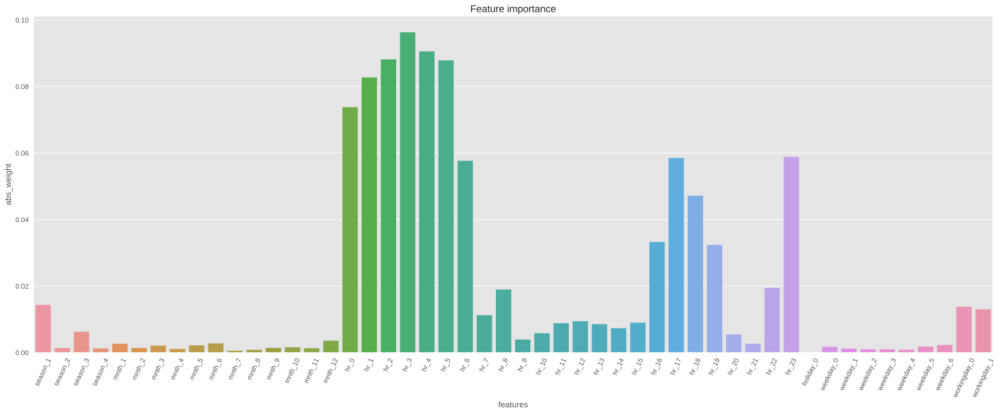

In [334]:
get_feature_importance(xgbr_model)

* Looking at the features and their importance for the model, it is quite logical to see among the important features: the particular hours, since in EDA it was revealed that from the hour the demand for bicycles also grows or falls.


**Detecting heteroscedasticity/Analysis of residuals**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


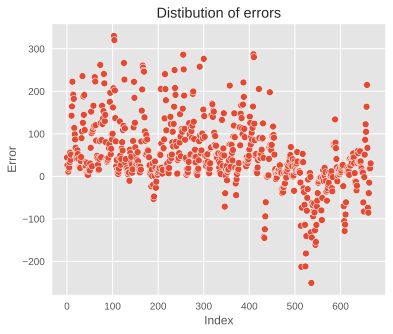

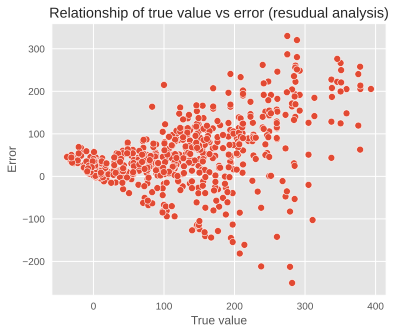

In [335]:
errors = test_label - pred
draw_res_analys(errors, pred)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.  

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [336]:
test_goldfeldquandt(errors, testData)

[('F statistic', 1.6251003055886921), ('p-value', 1.3217291728744872e-05)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.


It is worth noting that the Laplace distribution is more suitable for these residuals.

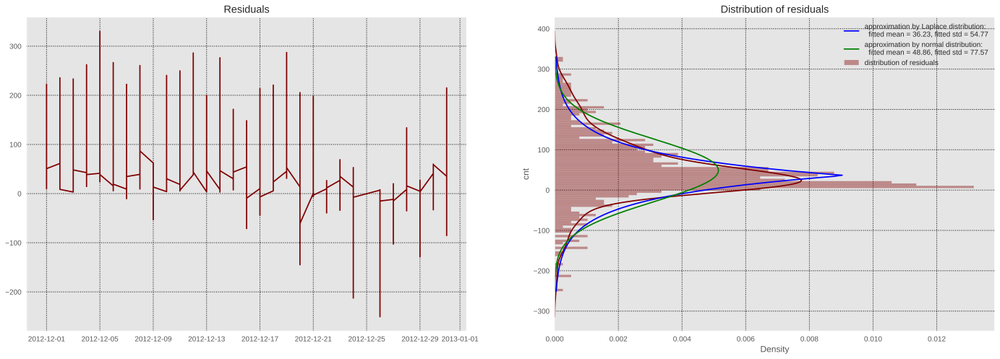

In [337]:
draw_resid_decomposition(errors)

It is worth noting that the Laplace distribution is more suitable for these residuals.

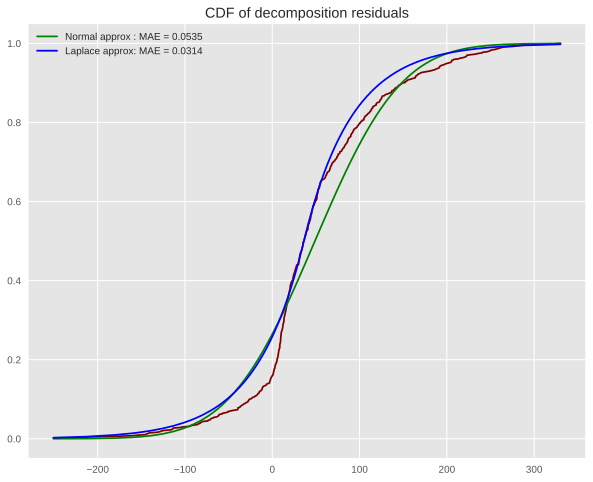

1.7031102108230276


In [338]:
ecdf_resid_instance = ECDF(errors.dropna())
resid_arr = errors.dropna().sort_values().values
ecdf_resid = ecdf_resid_instance(resid_arr)

loc_laplace, scale_laplace = st.laplace.fit(errors.dropna())
loc_norm, scale_norm = st.norm.fit(errors.dropna())
cdf_norm = st.norm.cdf(resid_arr, loc=loc_norm, scale=scale_norm)
cdf_laplace = st.laplace.cdf(resid_arr, loc=loc_laplace, scale=scale_laplace)
mae_norm = mean_absolute_error(ecdf_resid, cdf_norm)
mae_laplace = mean_absolute_error(ecdf_resid, cdf_laplace)
plt.subplots(1, 1, figsize=(10, 8))
plt.plot(resid_arr, ecdf_resid, '-', color='maroon')
plt.plot(resid_arr, cdf_norm, '-g', 
         label=f"Normal approx : MAE = {mae_norm:.3g}")
plt.plot(resid_arr, cdf_laplace, '-b', 
         label=f"Laplace approx: MAE = {mae_laplace:.3g}")
plt.legend()
plt.title("CDF of decomposition residuals")
plt.show()
print(mae_norm/mae_laplace)

Errors have Laplace distribution. MAE metric proofs it.

**Metrics**

**Errors on the train**

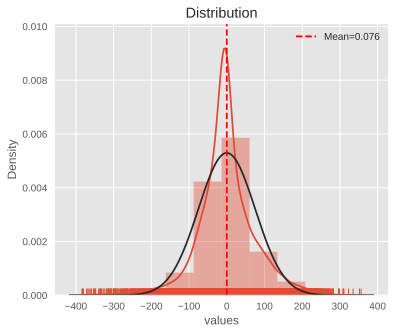

In [339]:
error = train_label - xgbr_model.predict(trainData)
draw_histogram(error)

In [340]:
print('MAE - Train:   ', mean_absolute_error(train_label, xgbr_model.predict(trainData)))

MAE - Train:    52.684083396887814


**Errors on the test**

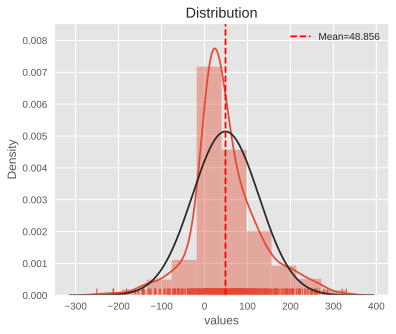

In [341]:
error = test_label - pred
draw_histogram(error)

In [342]:
print('MAE - Test:   ', mean_absolute_error(test_label, pred))

MAE - Test:    66.46551528899208


### **Conclusion**

* On the test, MAE score becomes worth, but this model shows the best results from all models above (it was best *MAE: 84.2*, it became *MAE: 66.5*).
* Of caurse, the result  is quit good.
* This model copes better with prediction than all others.


# **General conclusion**



* Seasonality is clearly present in the data, which was removed from the data and they were made stationary.

* The presence of a small trend was also revealed.

* It can be seen that temperature and wind speed affect the demand for bicycles. Temperature and absolute temperature graphs are very similar in nature. This indicated a high collinearity between these two functions. I abandoned one function to avoid multiple collinearity.

* It is also seen that the features of the working day, holiday, day of the month, day of the week affect the demand for bicycles slightly and only in some models.

* From the hourly chart, we can clearly see that the demand for bicycles is highest at 8 am and 5 pm.This is due to the high demand during working hours.

* It can be seen that we have obtained good accuracy on the values of the MAE metric.

------------------------------------

**Results:** 

* The best results on both the train and the test with a slight difference in performance were shown by *XGB regression* after tuning hyperparameters.

**TEST**  

**VAL**:    
MAE:   66.46 
 
----------------------
**ALL SCORES (MAE)**

+ LR: 86,6
+ Exog LR: 97,9
+ ARIMA: 84,2
+ ***Prophet: 112,97***
+ ***XGB: 66.46***
+ SARIMA: failed ((
------------------------------    

* After I built several models, and also carried out some tuning of hyperparameters, basically the MAE score, for example, was not bigger than *MAE: 100.0...* both on train and test, but I wanted to get a lower score.

* The *prophet* proved to be the worst on the presented data (*MAE*: 112,97).

* Also, probably next time you can try to exclude months and time from the data, since it was impossible to check. are the data cyclical in nature, since the dataset was presented in just 2 years and some dependencies were identified during only this small amount of time.

* I also think that it is possible to improve the models with weaker indicators with the help of more fine-tuning of hyperparameters.

---------------------------------------------------------

Heteroscedasticity was found in the data in some models (not everywhere), which is bad for the regression model. Heteroscedasticity, the violation of homoscedasticity, occurs when we don’t have Why it can happen: Our model may be giving too much weight to a subset of the data, particularly where the error variance was the largest.

**What it will affect:** Significance tests for coefficients due to the standard errors being biased. Additionally, the confidence intervals will be either too wide or too narrow.

**How to detect it:** Plot the residuals and see if the variance appears to be uniform.

**How to fix it:** Heteroscedasticity  can be solved either by using weighted least squares regression instead of the standard OLS. One way to get rig of this thing is to penalize the points at larger variances. If we are seeking a linear fit to the data, the points with the larger noise/errors should be of lower influence than the points that lie close together. Enter weighted least squares (WLS) – in this method, the weights for each datapoint is scaled inversely as a function of its variance, thereby achieving the above goal.
Or transforming either the dependent or highly skewed variables. Performing a box-cox or a log transformation on the dependent variable is not a bad place to start.